In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import scanpy as sc
import os

import matplotlib.pyplot as plt



In [3]:
figure_folder = r'I:\MERFISH_Analysis\Merged_MOP\Figures_0626'
print(figure_folder)
if not os.path.exists(figure_folder):
    os.makedirs(figure_folder)
    
    
sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi=150, dpi_save=300, frameon=False, 
                              figsize=(4, 4), fontsize=8, facecolor='white', transparent=True)
sc.settings.figdir = figure_folder

I:\MERFISH_Analysis\Merged_MOP\Figures_0626


## define location to save figures

In [4]:
data_folders= [r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\v2\20220304-storm6_M1', 
               r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\v2\20220329-storm6_M1', 
               r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\v2\20220415-storm65', 
               r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\v2\20220418-storm6',
              ]

adata_list = []
for _data_folder in data_folders:
    
    cell_meta_data_file = os.path.join(_data_folder, 'ExportCellMetadata', 'feature_metadata.csv')
    cell_meta_data = pd.read_csv(cell_meta_data_file)
    counts_file_mer = os.path.join(_data_folder, 'ExportPartitionedBarcodes', 'barcodes_per_feature.csv')
    df = pd.read_csv(counts_file_mer).rename(columns={'Unnamed: 0':'index'}).set_index('index')
    for _c in df.columns:
        if 'Blank-' in _c:
            df = df.drop(columns=_c)
    adata = anndata.AnnData(df)
    adata.obs = adata.obs.merge(cell_meta_data, left_index=True, right_on='Unnamed: 0').set_index('Unnamed: 0')
    adata.obs['experiment'] = os.path.basename(_data_folder).split('-')[0]
    
    #_postanalysis_folder = os.path.join(_data_folder, 'PostAnalysis')
    #_save_filename = os.path.join(os.path.join(_postanalysis_folder, 'filtered_cluster_data.h5ad'))
    #_data = sc.read(_save_filename)
    adata_list.append(adata)
    

C:\Users\puzheng\AppData\Local\Temp\2/ipykernel_84084/376269533.py:17: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = anndata.AnnData(df)
C:\Users\puzheng\AppData\Local\Temp\2/ipykernel_84084/376269533.py:17: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = anndata.AnnData(df)
C:\Users\puzheng\AppData\Local\Temp\2/ipykernel_84084/376269533.py:17: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get t

In [5]:
merged_adata = anndata.concat(adata_list, )

# 3. Preprocess and filter the MERFISH data 

In [7]:
# Calculate quality control metrics
sc.pp.calculate_qc_metrics(merged_adata, percent_top=None, log1p=False, inplace=True)

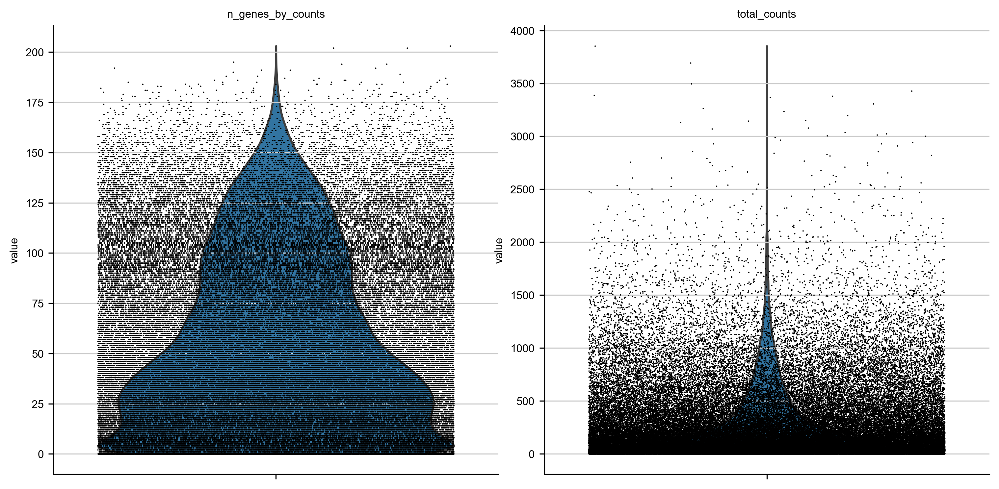

In [8]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(merged_adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

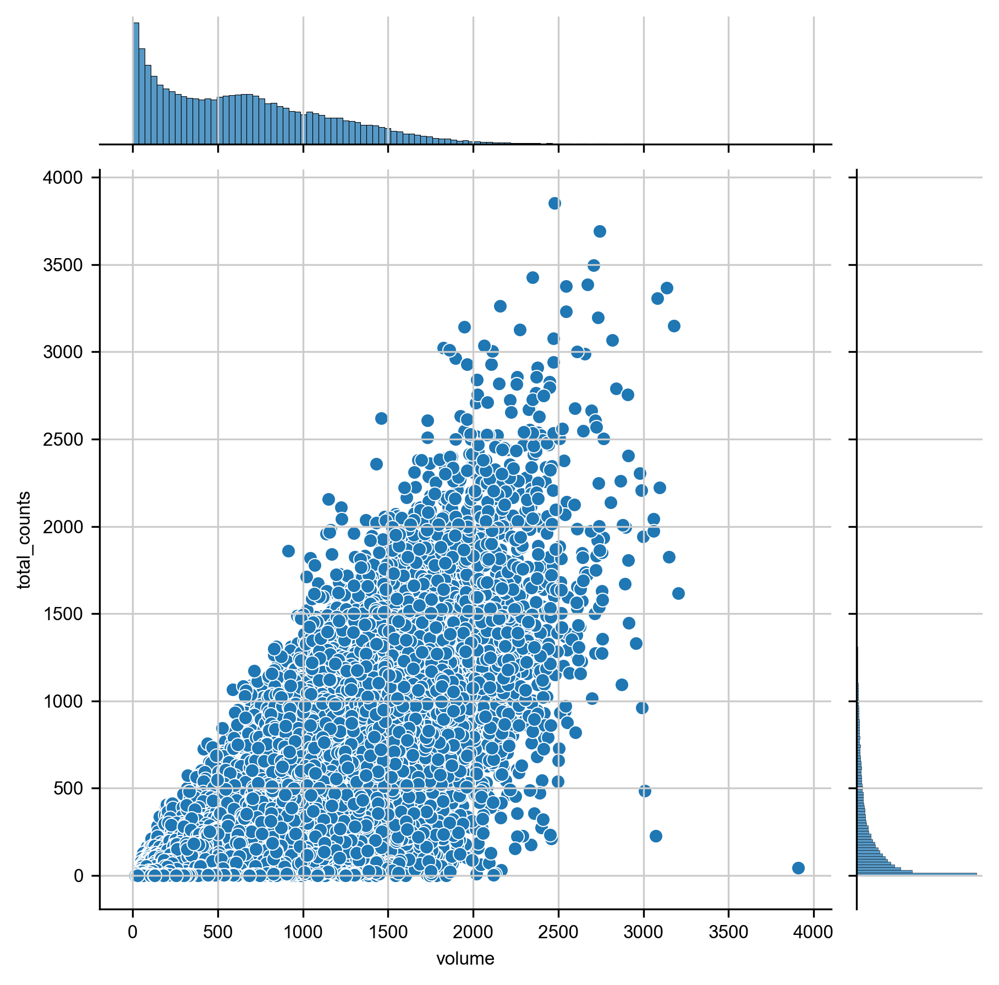

In [9]:
sns.jointplot(data=merged_adata.obs, x='volume', y='total_counts')

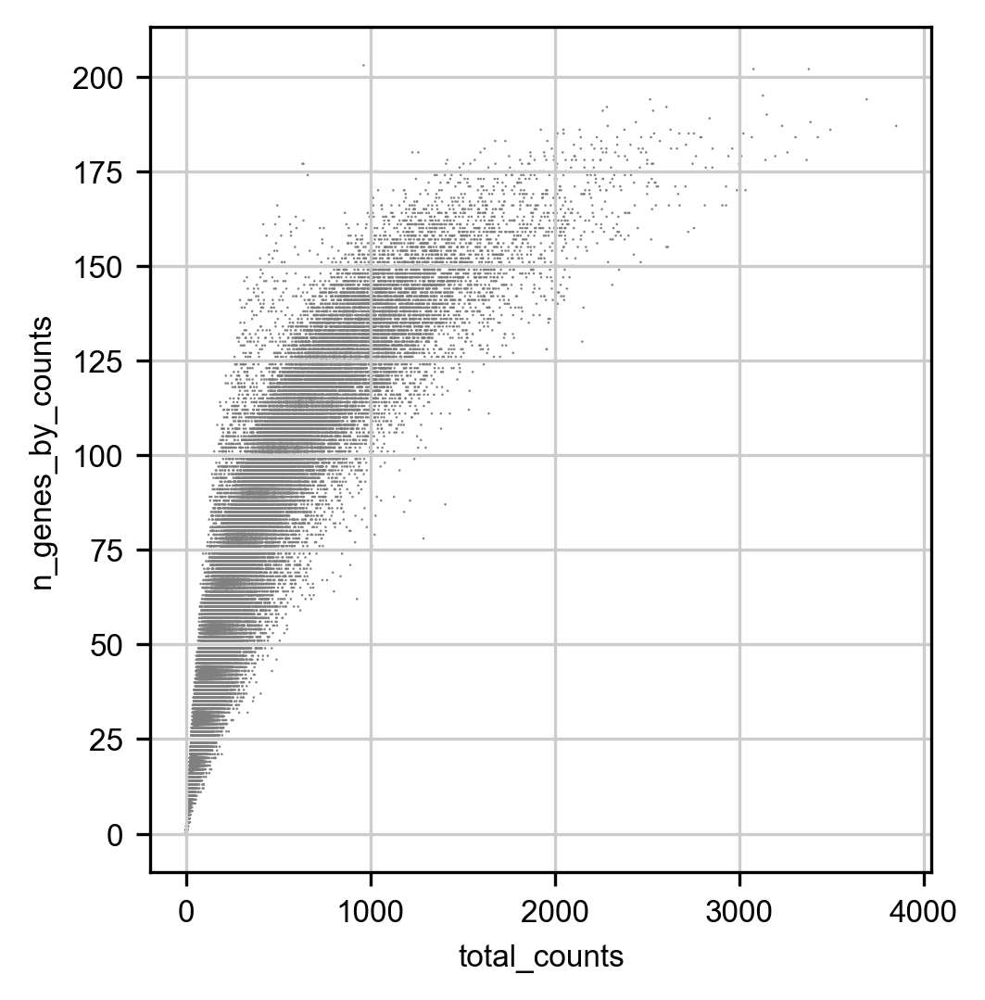

In [10]:
# Plot the distributions of gene counts
sc.pl.scatter(merged_adata, x='total_counts', y='n_genes_by_counts')

In [11]:
gene_count_threshold = 10
total_count_threshold = 20
volume_threshold = 100
volume_upper_threshold = 5000
# Filtering
merged_adata = merged_adata[merged_adata.obs['n_genes_by_counts'] > gene_count_threshold]
merged_adata = merged_adata[merged_adata.obs['total_counts'] > total_count_threshold]
merged_adata = merged_adata[merged_adata.obs['volume'] > volume_threshold]
merged_adata = merged_adata[merged_adata.obs['volume'] <= volume_upper_threshold]

print(len(merged_adata))

63431


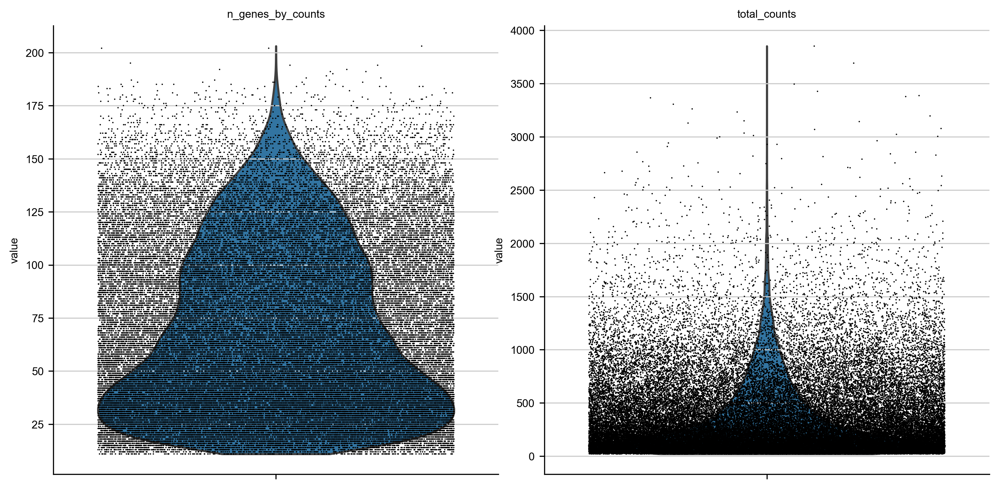

In [12]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(merged_adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

In [13]:
np.mean(merged_adata.obs['total_counts'])

355.3042297363281

## filter doublet

In [14]:
sc.external.pp.scrublet(merged_adata)

E:\Users\puzheng\AppData\anaconda3\envs\ia3_postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
E:\Users\puzheng\AppData\anaconda3\envs\ia3_postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:182: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


Automatically set threshold at doublet score = 0.81
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


E:\Users\puzheng\AppData\anaconda3\envs\ia3_postanalysis\lib\site-packages\scanpy\external\pp\_scrublet.py:227: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = adata_obs.obs['doublet_score']


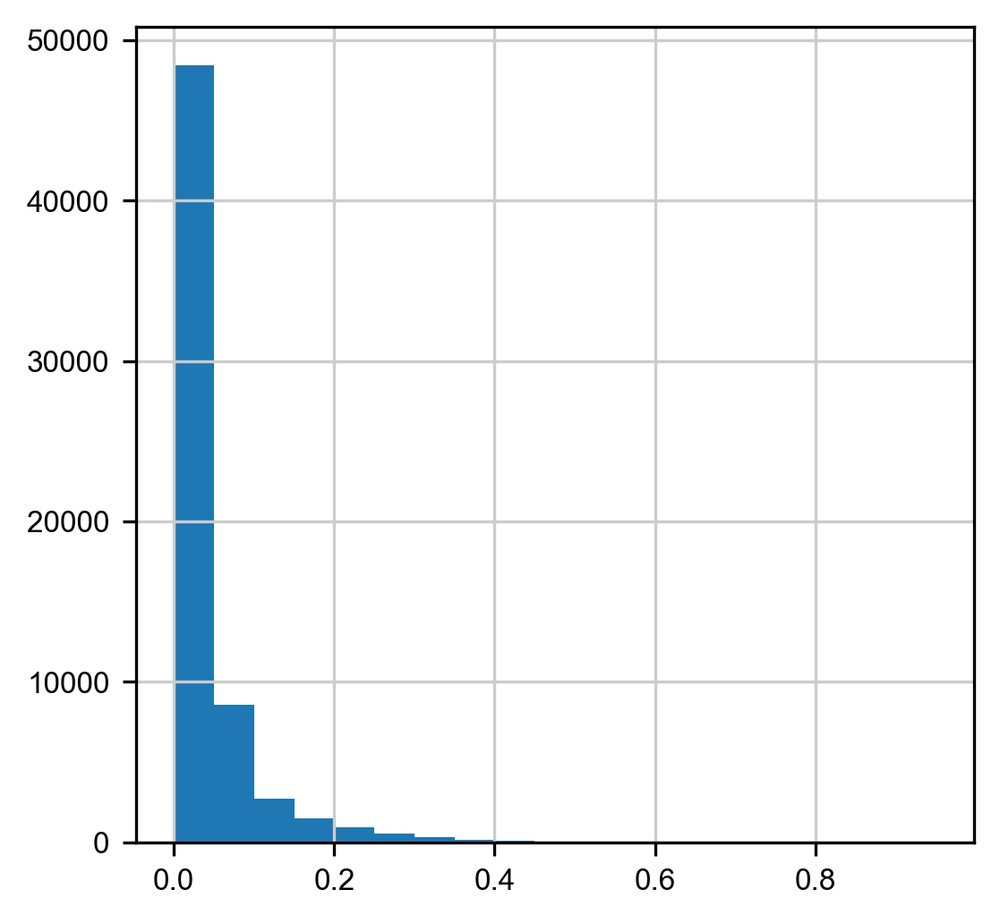

0.006400655830745219

In [17]:
plt.figure()
plt.hist(merged_adata.obs['doublet_score'], bins=np.arange(0,1,0.05))
plt.show()
np.mean(merged_adata.obs['doublet_score'] > 0.35)

In [24]:
# remove potential doublet
doublet_score_th = 0.3
merged_adata = merged_adata[merged_adata.obs['doublet_score'] <= doublet_score_th]
len(merged_adata)

62709

# 4. PCA and UMAP of the MERFISH data (for quick test)

E:\Users\puzheng\AppData\anaconda3\envs\ia3_postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


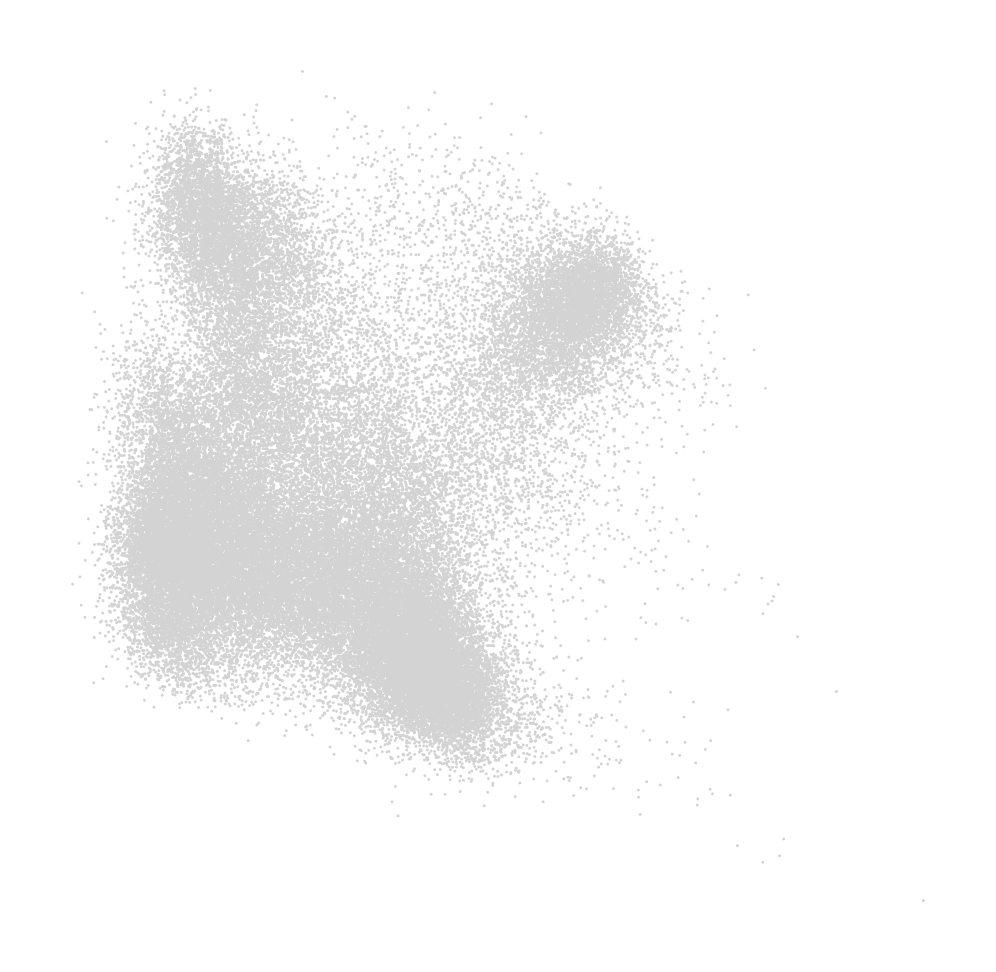

Wall time: 45.1 s


In [19]:
%%time
# Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell
sc.pp.normalize_total(merged_adata, target_sum=1e2)
# Logarithmize the data
sc.pp.log1p(merged_adata)
# Regress out total counts
sc.pp.regress_out(merged_adata, 'total_counts')
# Convert gene expressions to Z-scores
sc.pp.scale(merged_adata, max_value=10)
# Principal component analysis
sc.tl.pca(merged_adata, svd_solver='arpack')
# Plot the PCA results
sc.pl.pca(merged_adata)

In [27]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(merged_adata, n_neighbors=10, n_pcs=50)
# Clustering
sc.tl.leiden(merged_adata, resolution=1)

Wall time: 29.1 s


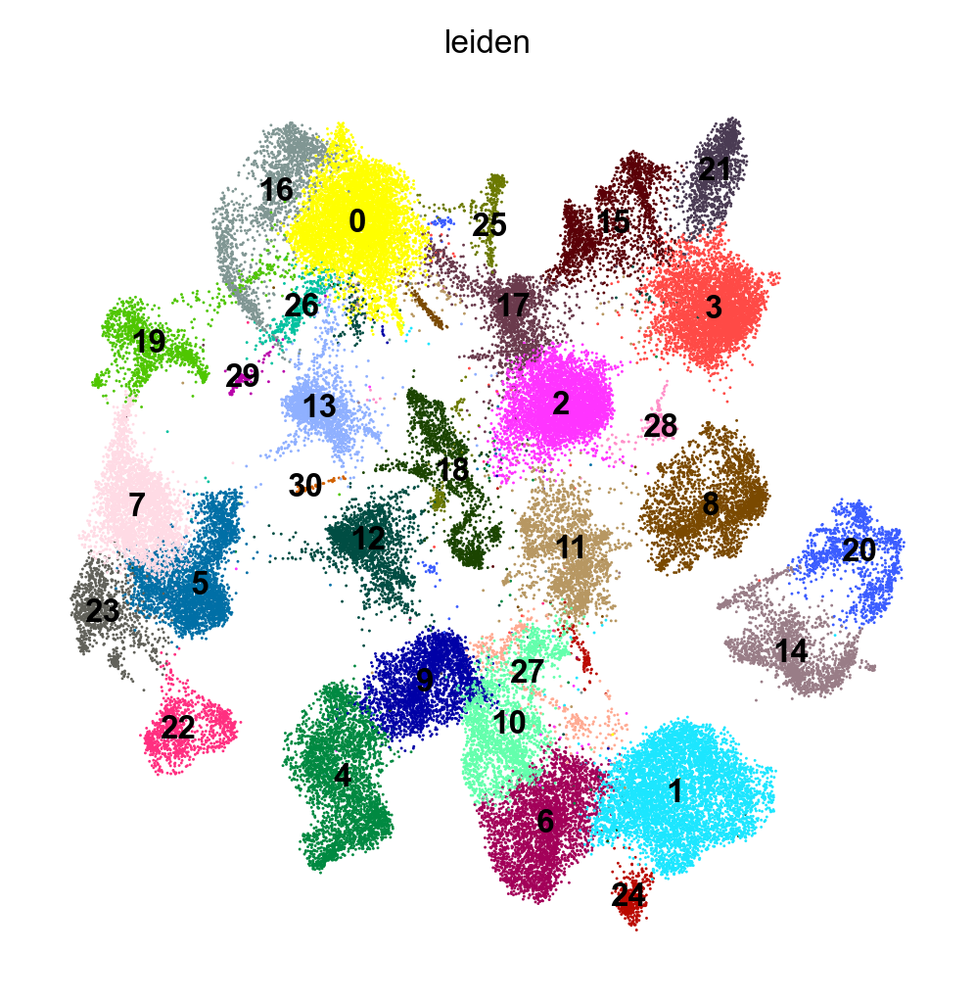

Wall time: 2min 30s


In [28]:
%%time
# Embed with UMAP
sc.tl.umap(merged_adata)
# Plot the UMAP
sc.pl.umap(merged_adata, color='leiden', legend_loc='on data')

## 4.2 check reproduciblilty

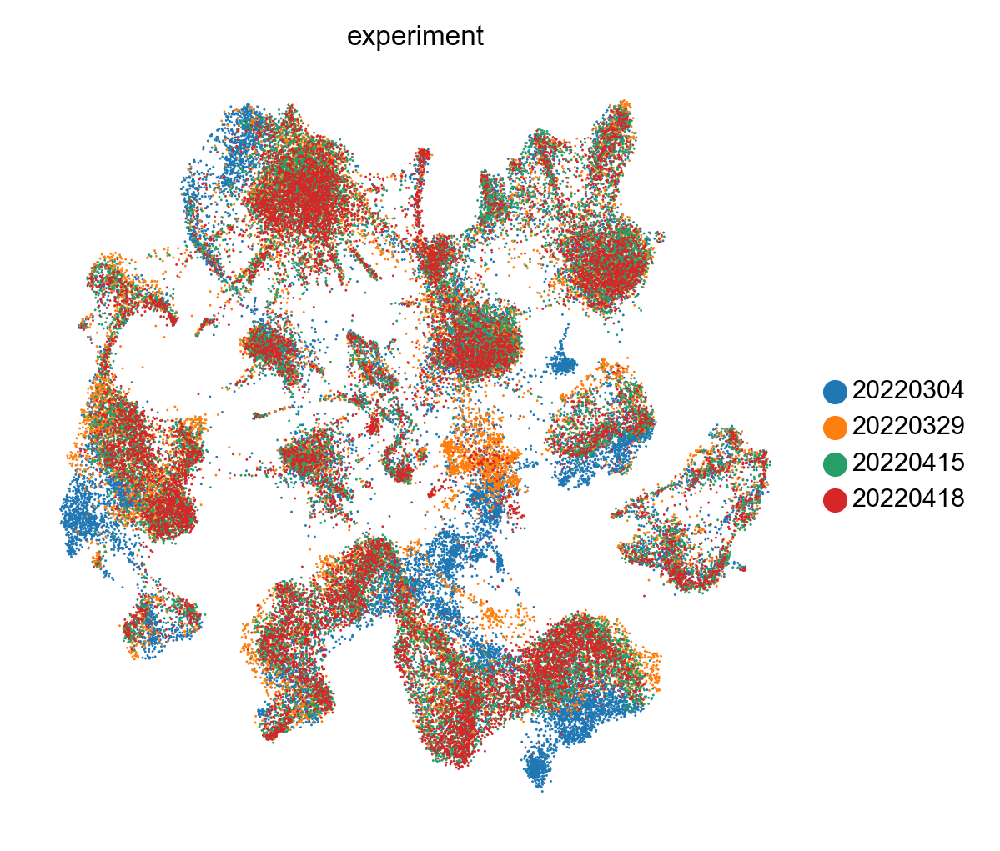

In [29]:
# Plot Umap of different experimental replcates
sc.pl.umap(merged_adata, color='experiment', )

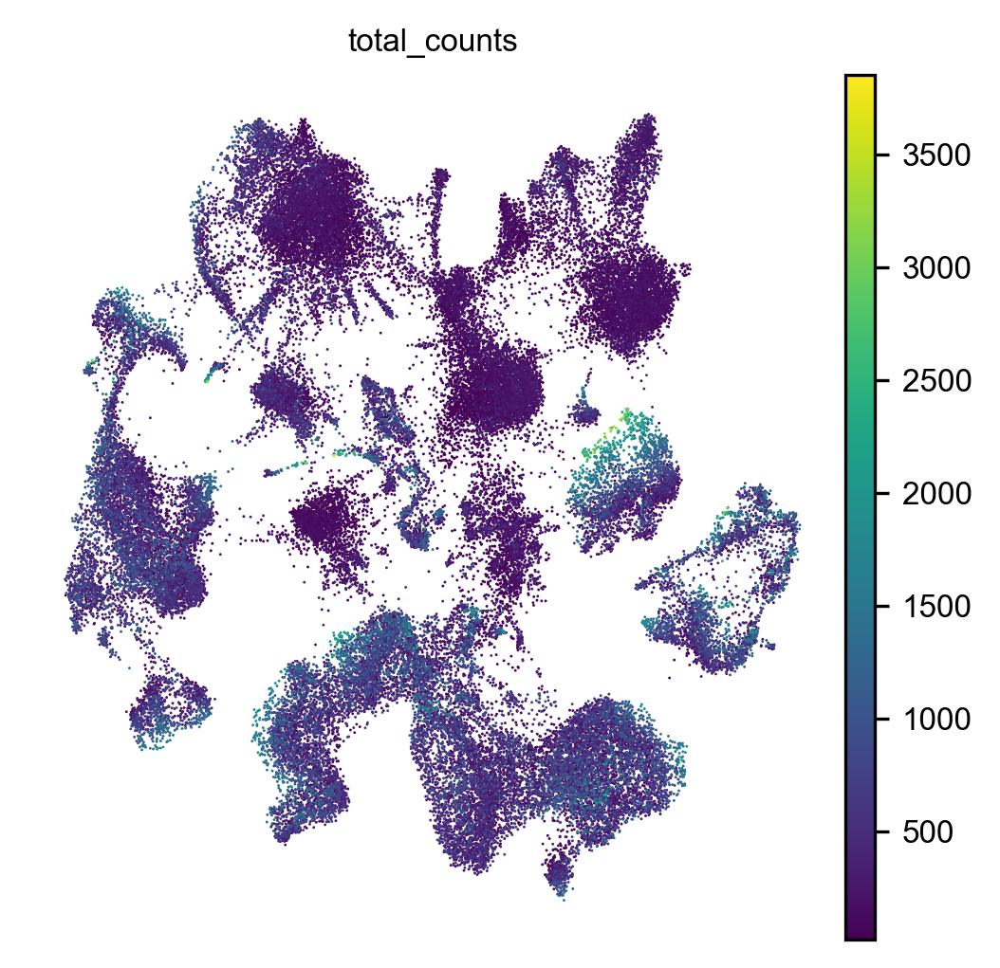

In [30]:
sc.pl.umap(merged_adata, color='total_counts')

# 5. Check count for each cell for genes of interest

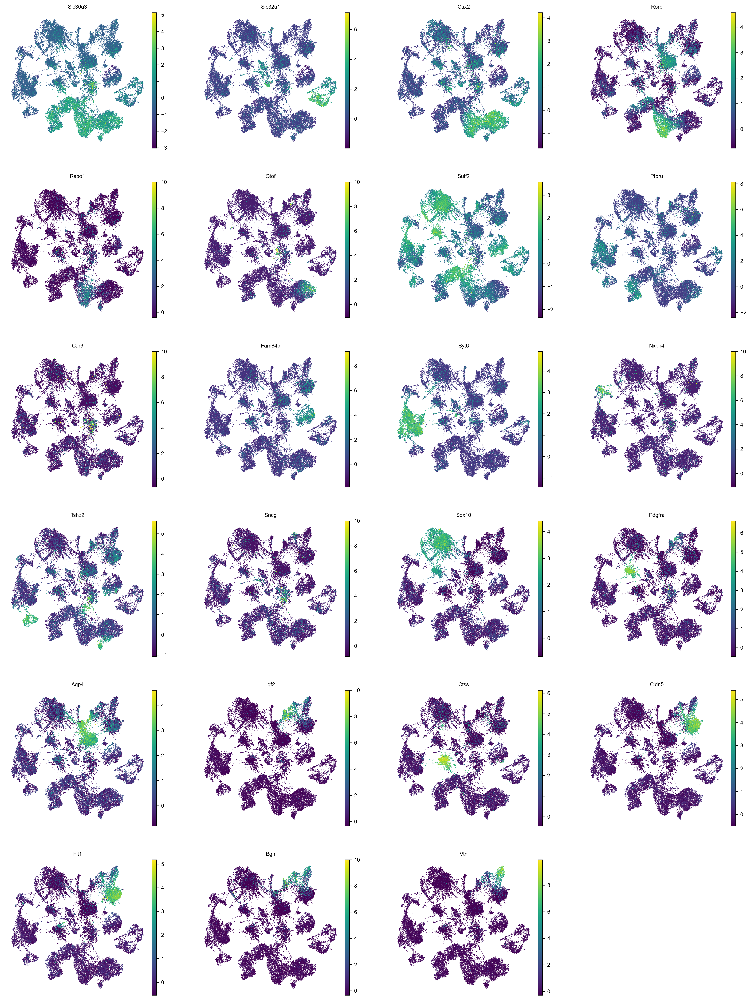

In [31]:
# Visualize marker genes
marker_genes = ['Slc17a7', 'Slc30a3', 'Slc32a1', 'Cux2', 'Rorb', 'Rspo1','Otof','Sulf2', 'Ptpru', 'Car3', 'Fam84b', 'Syt6', 
               'Nxph4', 'Tshz2', 'Pvalb', 'Sst', 'Vip', 'Sncg', 'Lamp5', 'Sox10', 'Pdgfra', 'Aqp4', 'Igf2',
               'Ctss', 'Cldn5', 'Flt1', 'Bgn', 'Vtn']
marker_genes = [g for g in marker_genes if (g in merged_adata.var.index)]

sc.pl.umap(merged_adata, color=marker_genes)

In [32]:
merged_adata.obs['leiden_subclass'] = merged_adata.obs.leiden

# 6 Test different parameters for UMAP

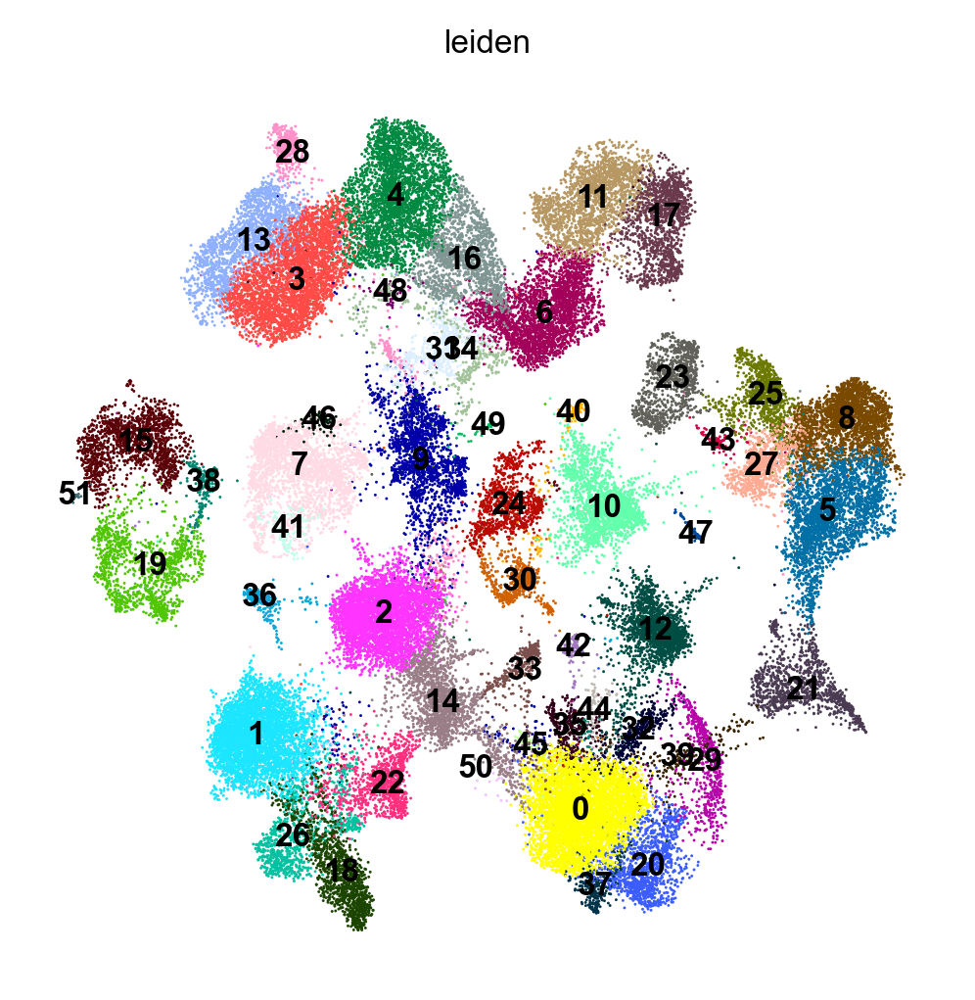

Wall time: 2min 2s


In [33]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(merged_adata, n_neighbors=8, n_pcs=50)

sc.tl.leiden(merged_adata, resolution=2.)

sc.tl.umap(merged_adata)
# Plot the UMAP
sc.pl.umap(merged_adata, color='leiden', legend_loc='on data')

# save this new labels as a new column as 'leiden_subclass'
merged_adata.obs['leiden_cluster'] = merged_adata.obs.leiden

# 7. Save the analyzed MERFISH adata in h5ad for later use (e.g., cell classifer)

In [34]:
save_folder = r'I:\MERFISH_Analysis\Merged_MOP'
save_filename = os.path.join(save_folder, 'filtered_cluster_data.h5ad')

overwrite = True

if not os.path.exists(save_filename) or overwrite:
    print(f"save adata into file: {save_filename}")
    merged_adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")

save adata into file: I:\MERFISH_Analysis\Merged_MOP\filtered_cluster_data.h5ad


# 8. Cell type classifier

In [35]:
# read from file
save_folder = r'I:\MERFISH_Analysis\Merged_MOP'
save_filename = os.path.join(save_folder, 'filtered_cluster_data.h5ad')
merged_adata = sc.read(save_filename)

## 8.1 load Meng's dataset

In [36]:
meng_merfish_raw = r'\\mendel\Mendel_SSD3\MERFISH_Analysis\Meng_data\counts.h5ad'
merfish_raw = sc.read_h5ad(meng_merfish_raw)
meng_merfish_label = r'\\mendel\Mendel_SSD3\MERFISH_Analysis\Meng_data\cell_labels.csv'
merfish_label = pd.read_csv(meng_merfish_label, index_col=0)

In [37]:
merData = pd.DataFrame(merfish_raw.X, index = merfish_raw.obs.index, columns = merfish_raw.var.index)
labels = merfish_label.loc[merfish_label['label']!='-1']
# merge dataframes
merCluster=merData.merge(labels, how='inner', left_index=True, right_index=True)

In [38]:
from sklearn import preprocessing
# Scale variable measurements for model training
merGroupedDataZ = pd.DataFrame(preprocessing.scale(merCluster.iloc[:,:-5]),index = merCluster.iloc[:,:-5].index, columns = merCluster.iloc[:,:-5].columns)

merGroupedDataZ['subclass'] = merCluster.iloc[:,-2]

E:\Users\puzheng\AppData\anaconda3\envs\ia3_postanalysis\lib\site-packages\sklearn\preprocessing\_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
E:\Users\puzheng\AppData\anaconda3\envs\ia3_postanalysis\lib\site-packages\sklearn\preprocessing\_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


## 8.2 train classfier with Meng's dataset

In [39]:
adata_ref = merGroupedDataZ

# Train the classifer using the shared varibales
genes_from_ref = set(merData.columns)
genes = list(genes_from_ref.intersection(set(merged_adata.var.index)))

In [ ]:
%%time
from sklearn.neural_network import MLPClassifier

# Train a classifier
gene_ids = [merData.columns.get_loc(g) for g in genes]

print('Train cell type classifier.')

X = np.array(adata_ref.iloc[:,:-1])[:, gene_ids]
Y = np.array(adata_ref['subclass'])
nnc = MLPClassifier(max_iter = 500)
nnc.fit(X, Y)

Train cell type classifier.


In [ ]:
import pickle
pickle.dump(nnc, open(os.path.join(save_folder, 'trained_MLP_classifier.pkl'), 'wb'), )

# 8.3 initial prediction

In [64]:
%run "..\..\..\Startup_py3.py"
sys.path.append(r"..\..\..\..\Documents")

import ImageAnalysis3 as ia
import ImageAnalysis3.celltype_tools.classifier as clsf

Predict cell types.


C:\Users\puzheng\AppData\Local\Temp\2/ipykernel_62908/792457105.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


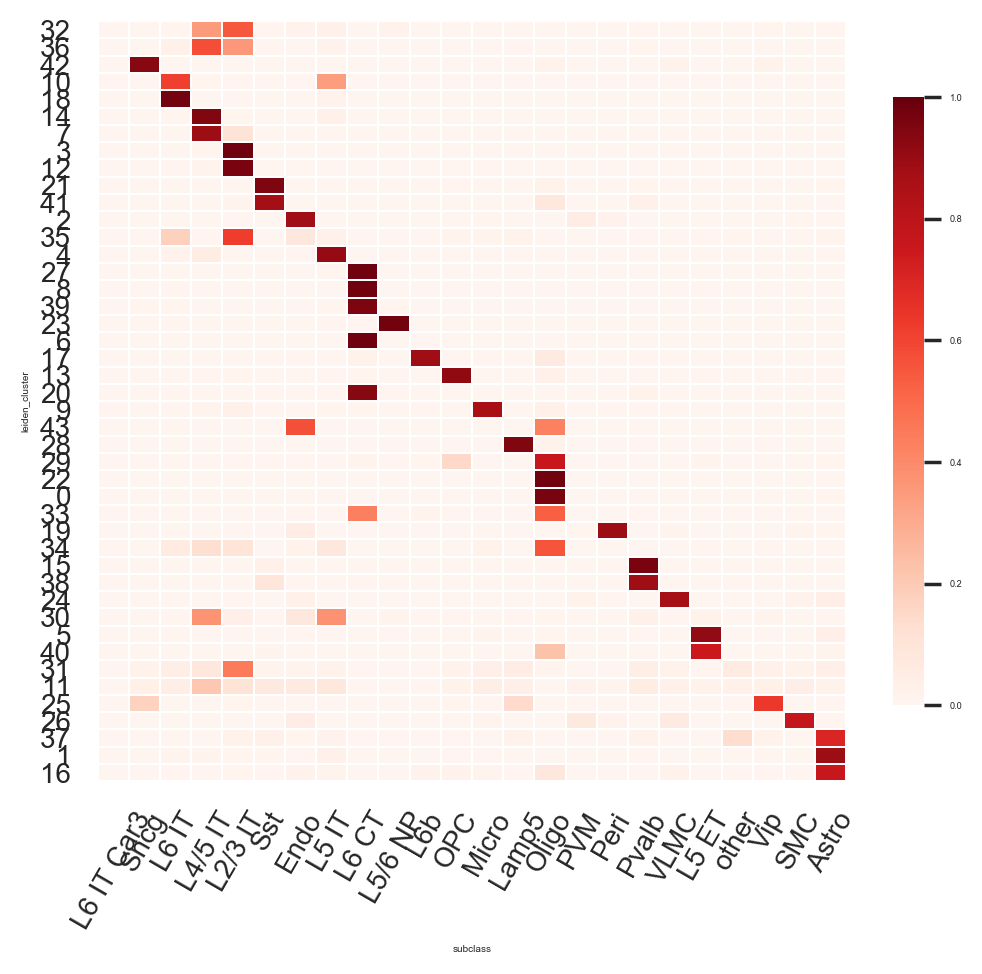

In [66]:
prediction_column = 'subclass_prediction_label'

ref_cluster_column = 'subclass'

# determine which class to query
query_cluster_column = 'leiden_cluster'
#query_cluster_column = 'leiden_cluster'

print('Predict cell types.')
clsf.predict_classes(nnc, merged_adata, prediction_column, genes)
 
    
## Count predictions
prediction_counts = merged_adata.obs[[query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')
    
# Plot
fig1=plt.figure(figsize = (6,5),dpi=100)
#sns.set(font_scale=0.3)
#sns.heatmap(fractions_sorted, cmap='Greys', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
    
sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .8})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 60)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column) 
plt.ylabel(query_cluster_column)
plt.show()

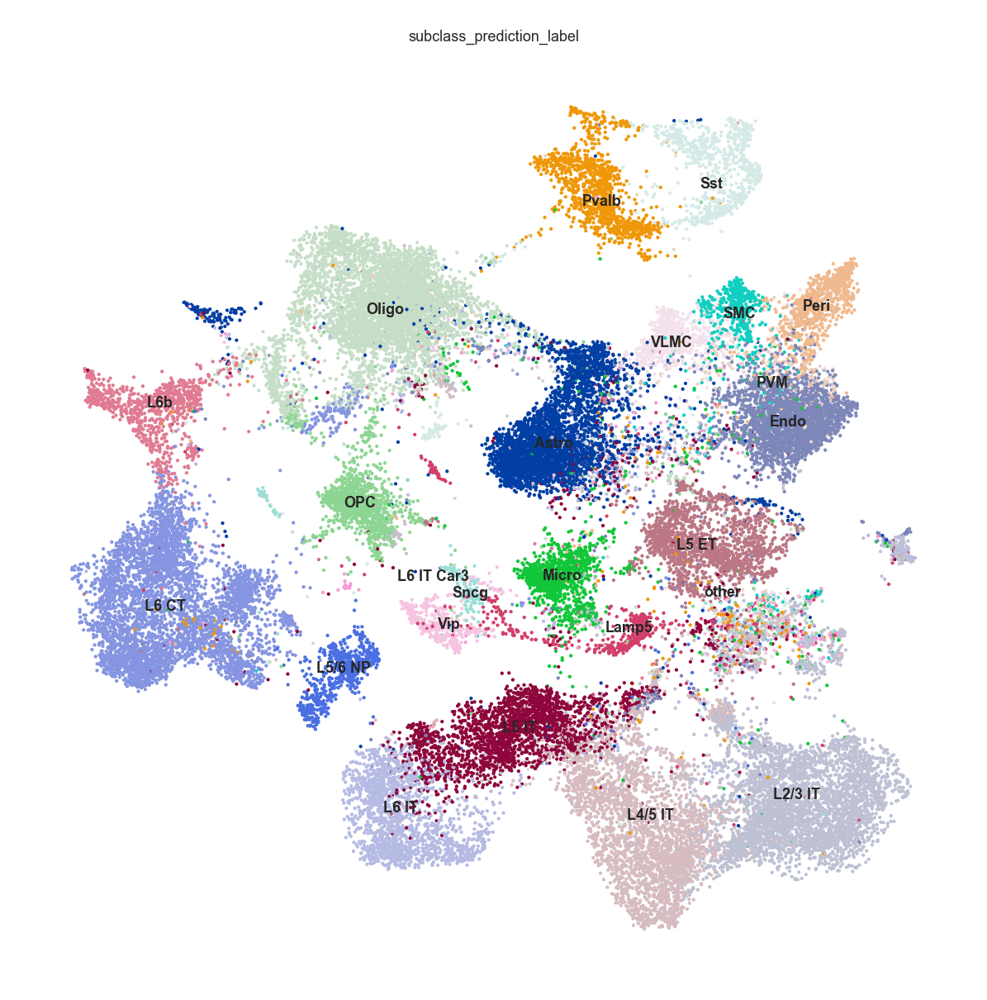

In [67]:
# Plot the predicted labels on UMAP to guide the manual labeling of the de novo clustering below
# use this to manually merge and split the original query column (e.g., leiden_subclass)
sc.pl.umap(merged_adata, color='subclass_prediction_label', legend_loc='on data')

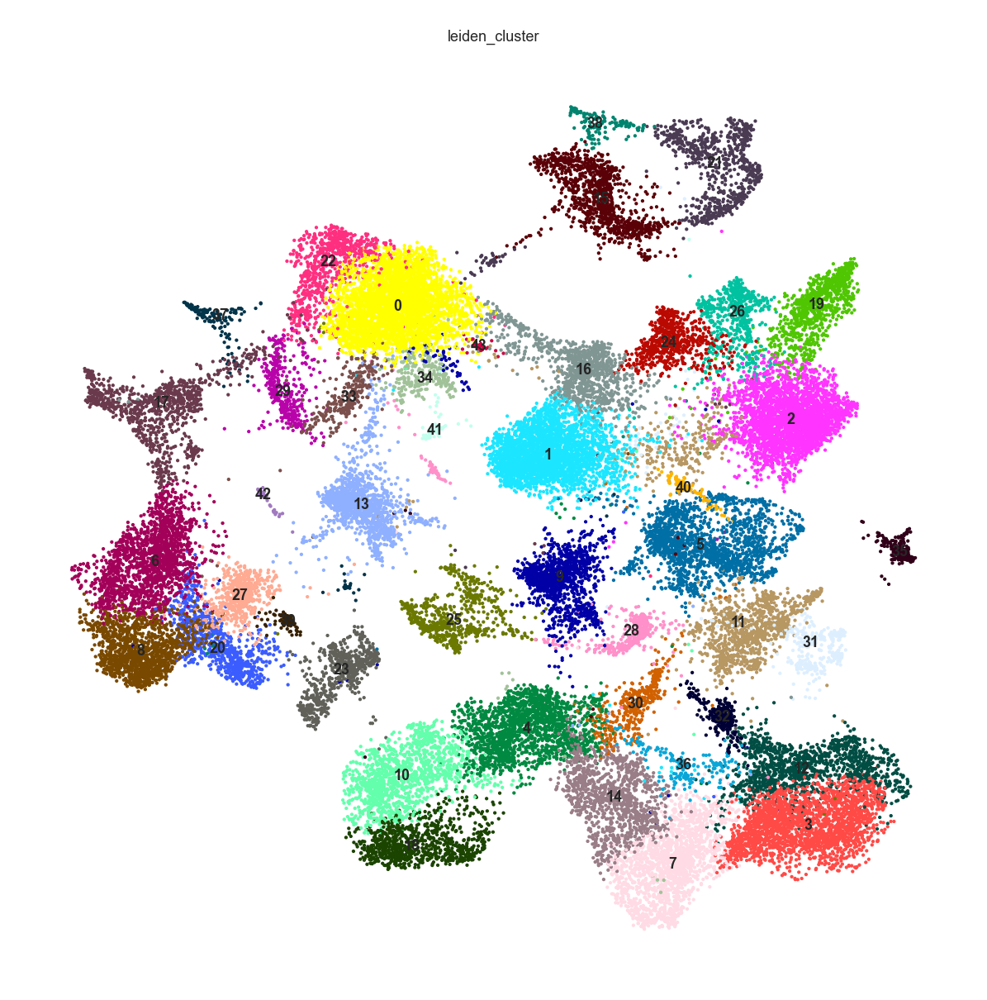

In [70]:
# Plot clustering as ref
sc.pl.umap(merged_adata, color='leiden_cluster', legend_loc='on data')

## 8.4 Split labels

by comparing two UMAP above, we could estimate which cluster should be further splitted

In [95]:
merged_adata.obs['leiden_subclass_sub'] = merged_adata.obs['leiden_cluster'] 
# manual split
sc.tl.leiden(merged_adata, resolution=0.5, restrict_to=('leiden_subclass_sub',['2']), key_added='leiden_subclass_sub')
sc.tl.leiden(merged_adata, resolution=0.5, restrict_to=('leiden_subclass_sub',['25']), key_added='leiden_subclass_sub')

#sc.tl.leiden(merged_adata, resolution=0.5, restrict_to=('leiden_subclass_sub',['11']), key_added='leiden_subclass_sub')
sc.tl.leiden(merged_adata, resolution=0.5, restrict_to=('leiden_subclass_sub',['30']), key_added='leiden_subclass_sub')


#sc.tl.leiden(merged_adata, resolution=0.2,restrict_to=('leiden_subclass_sub',['16,1']), key_added='leiden_subclass_sub')
#sc.tl.leiden(merged_adata, resolution=0.5,restrict_to=('leiden_subclass_sub',['23,0']), key_added='leiden_subclass_sub')
#sc.tl.leiden(merged_adata, resolution=0.5,restrict_to=('leiden_subclass_sub',['23,2']), key_added='leiden_subclass_sub')

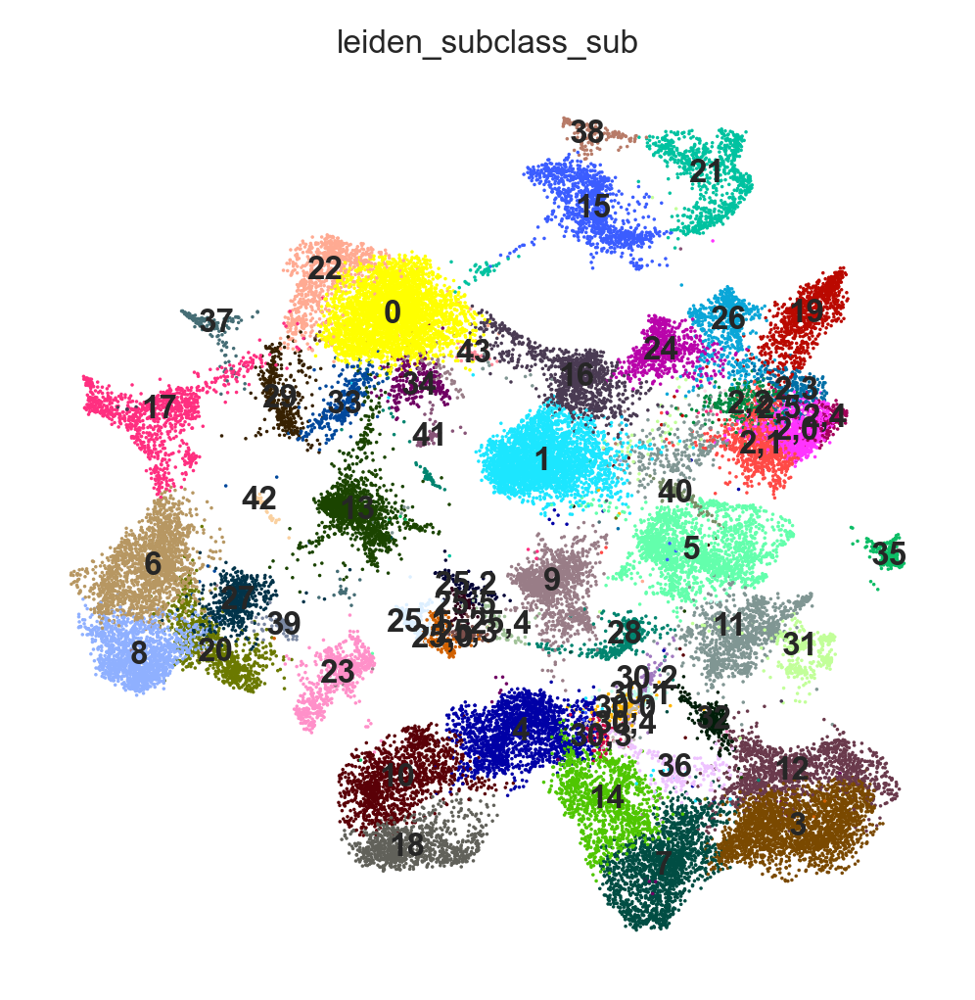

In [96]:
sc.pl.umap(merged_adata, color='leiden_subclass_sub', legend_loc='on data', cmap='Spectral')

## 8.5 further predict splitted groups

Predict cell types.


C:\Users\puzheng\AppData\Local\Temp\2/ipykernel_62908/2326176088.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


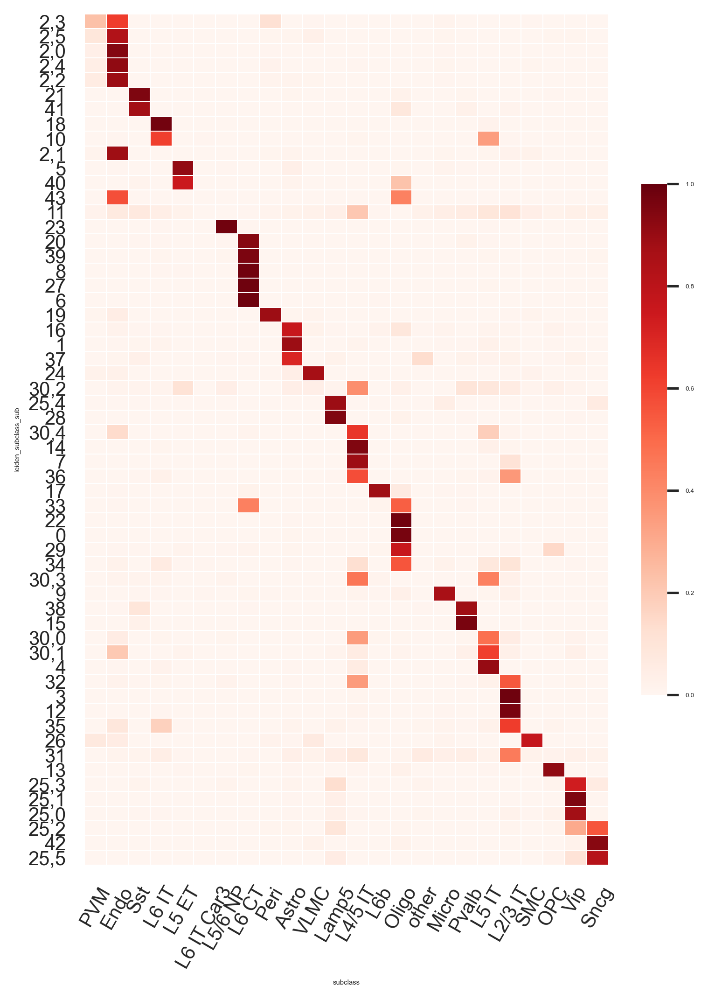

In [97]:
prediction_column = 'subclass_prediction_label'

ref_cluster_column = 'subclass'

# determine which class to query
query_cluster_column = 'leiden_subclass_sub'
#query_cluster_column = 'leiden_cluster'

print('Predict cell types.')
clsf.predict_classes(nnc, merged_adata, prediction_column, genes)
 
    
## Count predictions
prediction_counts = merged_adata.obs[[query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')
    
# Plot
fig1=plt.figure(figsize = (6,8))
sns.set(font_scale=0.3)
#sns.heatmap(fractions_sorted, cmap='Greys', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
    
sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 60)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column) 
plt.ylabel(query_cluster_column)
plt.show()

## 8.6 Assign most of uniquely classfied clusters

In [98]:
first_assign_dict = {}
missed_classes = []
# Automatic assign best fit if applicable
assign_th = 0.5
for _cluster, _vec in fractions.iterrows():
    #_cluster, _vec
    _matched_inds = np.where(_vec >= assign_th)[0]
    # if uniquely matched:
    if len(_matched_inds) == 1:
        print(_cluster, list(_vec.keys())[_matched_inds[0]])
        first_assign_dict[_cluster] = list(_vec.keys())[_matched_inds[0]]
    else:
        missed_classes.append(_cluster)

0 Oligo
1 Astro
2,0 Endo
2,1 Endo
2,2 Endo
2,3 Endo
2,4 Endo
2,5 Endo
3 L2/3 IT
4 L5 IT
5 L5 ET
6 L6 CT
7 L4/5 IT
8 L6 CT
9 Micro
10 L6 IT
12 L2/3 IT
13 OPC
14 L4/5 IT
15 Pvalb
16 Astro
17 L6b
18 L6 IT
19 Peri
20 L6 CT
21 Sst
22 Oligo
23 L5/6 NP
24 VLMC
25,0 Vip
25,1 Vip
25,2 Sncg
25,3 Vip
25,4 Lamp5
25,5 Sncg
26 SMC
27 L6 CT
28 Lamp5
29 Oligo
30,1 L5 IT
30,4 L4/5 IT
32 L2/3 IT
33 Oligo
34 Oligo
35 L2/3 IT
36 L4/5 IT
37 Astro
38 Pvalb
39 L6 CT
40 L5 ET
41 Sst
42 Sncg
43 Endo


In [99]:
sc.settings.n_jobs = 24
#sc.settings.figdir = postanalysis_folder
sc.settings.set_figure_params(dpi=150, dpi_save=300, frameon=False, 
                              figsize=(4, 4), fontsize=8, facecolor='white',)

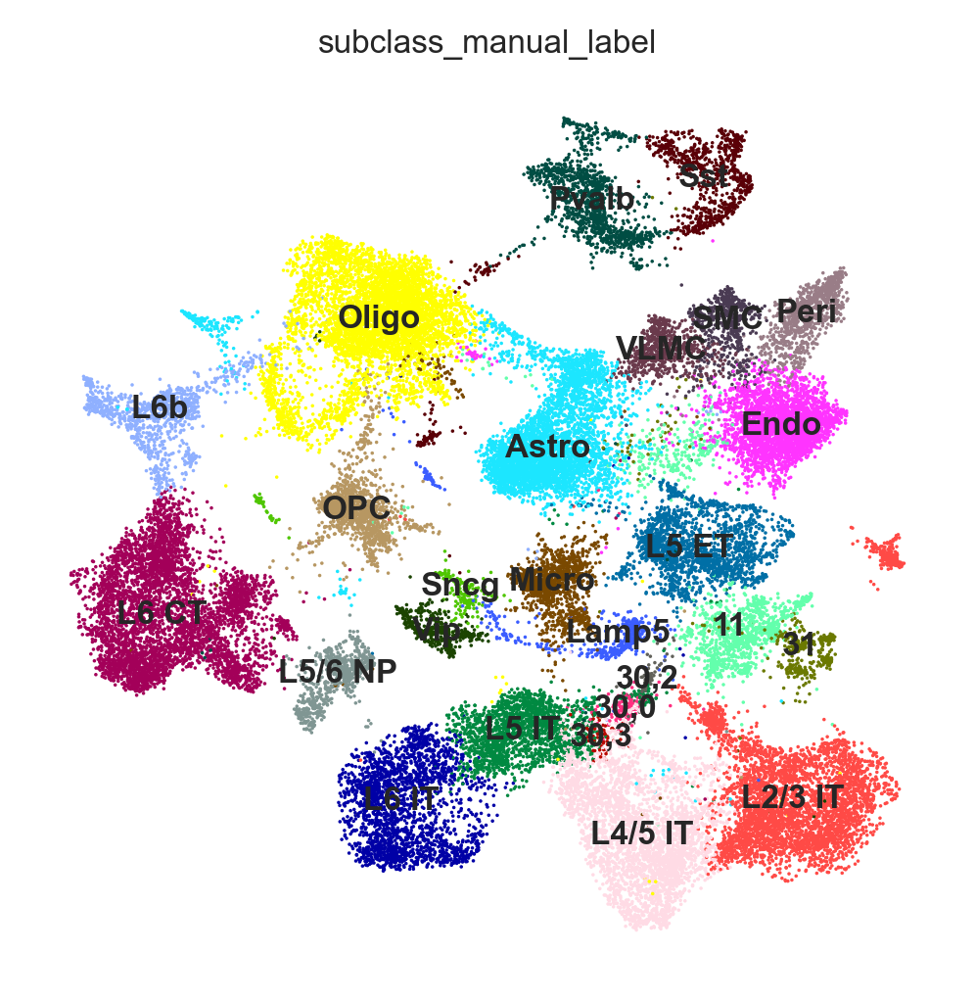

In [100]:
merged_adata.obs['subclass_manual_label'] = merged_adata.obs['leiden_subclass_sub'] 
merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':first_assign_dict})
# Check the leftover
np.unique(merged_adata.obs['subclass_manual_label'])
# Plot the predicted sub-subclass
sc.pl.umap(merged_adata, color='subclass_manual_label', legend_loc='on data',)

## 8.7 Manual assign leftovers

In [101]:
sc.settings.n_jobs = 24
#sc.settings.figdir = postanalysis_folder
sc.settings.set_figure_params(dpi=150, dpi_save=300, frameon=False, 
                              figsize=(4, 4), fontsize=8, facecolor='white',)

In [102]:
print(missed_classes)

for _cls in missed_classes:
    print(_cls)
    print((fractions.loc[_cls].index.values)[np.argsort(fractions.loc[_cls].values)[::-1]][::5])
    print(np.sort(fractions.loc[_cls].values)[::-1][::5])

['11', '30,0', '30,2', '30,3', '31']
11
['L4/5 IT' 'Pvalb' 'Sncg' 'OPC' 'L6b']
[0.20903522 0.05666156 0.03369066 0.02143951 0.00535988]
30,0
['L5 IT' 'L6 IT' 'L6b' 'L6 IT Car3' 'Sncg']
[0.48305085 0.00847458 0.00847458 0.         0.        ]
30,2
['L4/5 IT' 'Astro' 'L6 IT' 'Sst' 'PVM']
[0.38888889 0.04166667 0.01388889 0.01388889 0.        ]
30,3
['L4/5 IT' 'Sst' 'L6 CT' 'OPC' 'SMC']
[0.46268657 0.01492537 0.         0.         0.        ]
31
['L2/3 IT' 'L6 IT' 'SMC' 'Sst' 'L6b']
[0.44897959 0.04591837 0.02295918 0.01530612 0.        ]


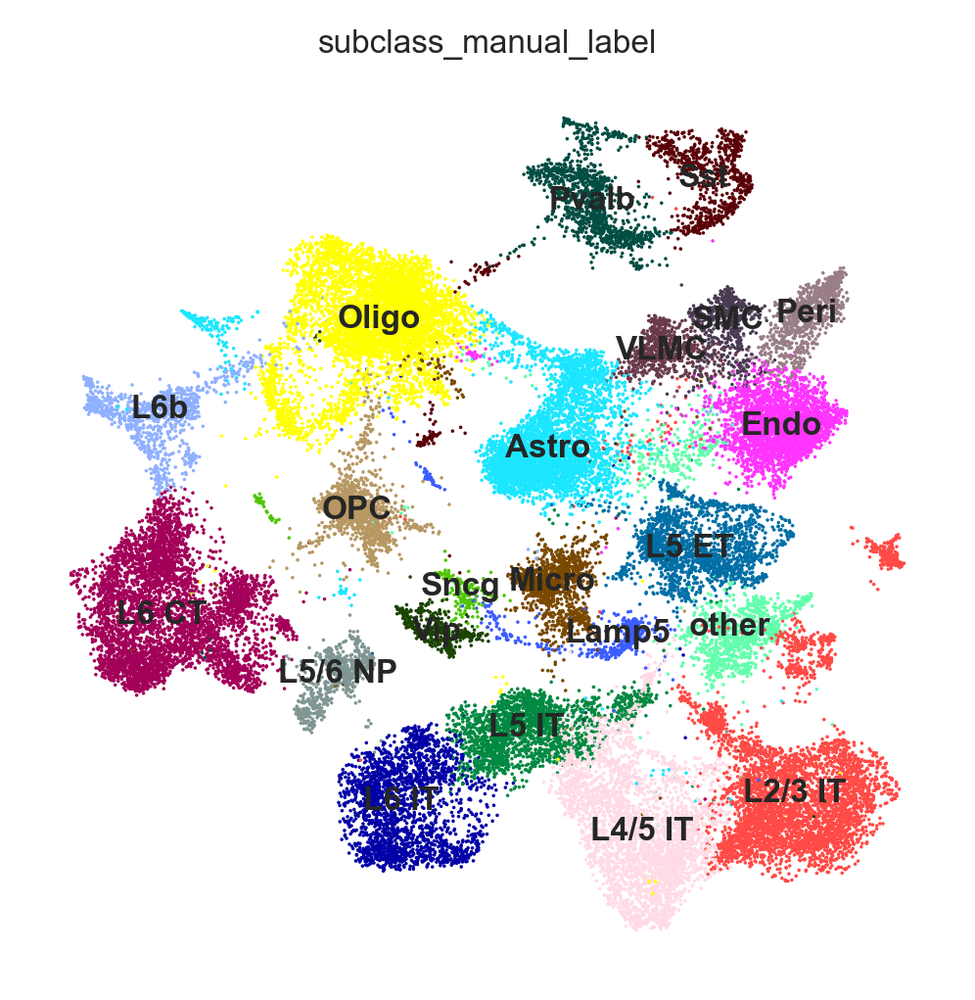

In [103]:
merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':{'11':'other'}})

merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':{'30,0':'L5 IT'}})
merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':{'30,2':'L4/5 IT', '30,3':'L4/5 IT'}})
merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':{'31':'L2/3 IT'}})

#merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':{'24,0':'L4/5 IT', '24,1':'L4/5 IT','24,2':'L4/5 IT','25,1':'L4/5 IT','25,2':'L4/5 IT'}})


#merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':{'25,1':'L6 CT'}})
#merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':{'27,0':'L5 ET'}})

np.unique(merged_adata.obs['subclass_manual_label'])

sc.pl.umap(merged_adata, color='subclass_manual_label', legend_loc='on data',)

meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped


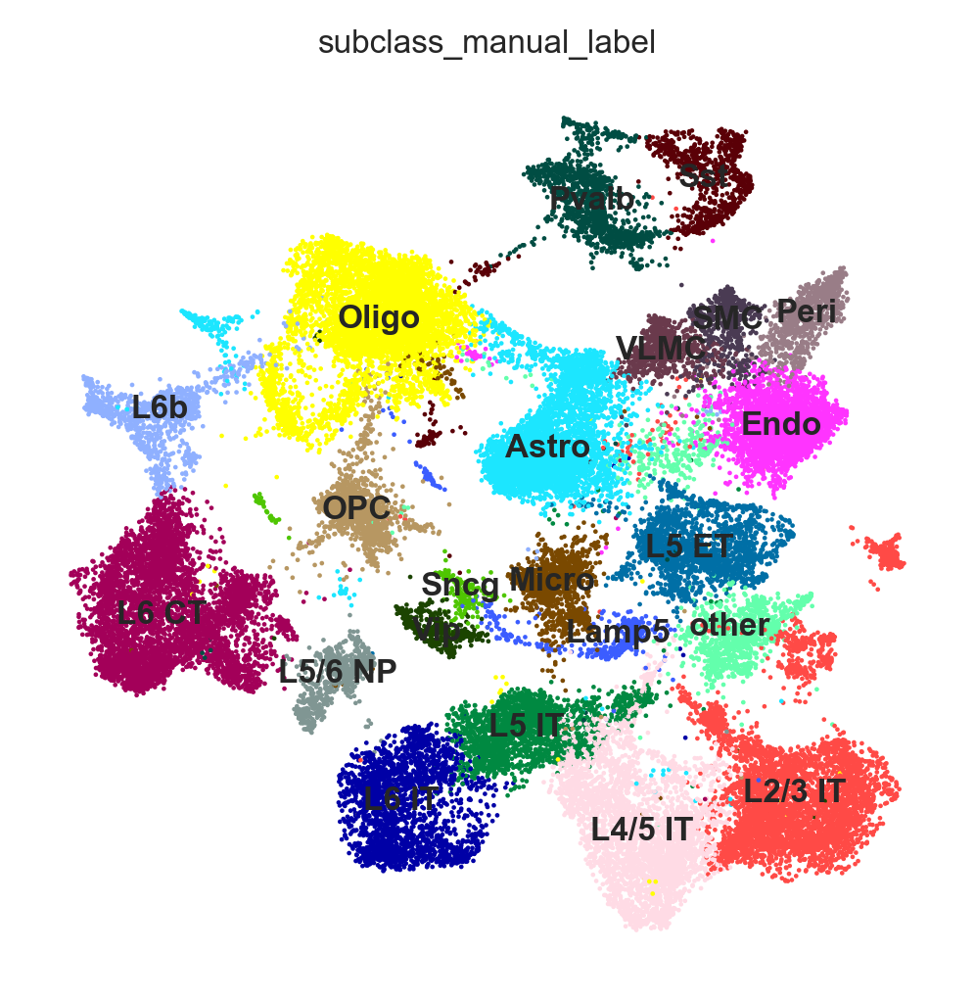

In [132]:
sc.pl.umap(merged_adata, color='subclass_manual_label', legend_loc='on data', size=5,
           cmap='Spectral',
           save='_manual_subclass')
#plt.savefig(os.path.join())

In [104]:
types, counts = np.unique(merged_adata.obs['subclass_manual_label'], return_counts=True)

In [105]:
for _type, _count in zip(types, counts):
    print(_type, _count)

Astro 4231
Endo 2848
L2/3 IT 4428
L4/5 IT 3219
L5 ET 1845
L5 IT 1967
L5/6 NP 650
L6 CT 4637
L6 IT 2183
L6b 957
Lamp5 471
Micro 1311
OPC 1301
Oligo 5303
Peri 850
Pvalb 1226
SMC 569
Sncg 197
Sst 879
VLMC 649
Vip 415
other 1306


C:\Users\puzheng\AppData\Local\Temp\2/ipykernel_62908/40977473.py:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(types, rotation=45)
C:\Users\puzheng\AppData\Local\Temp\2/ipykernel_62908/40977473.py:5: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


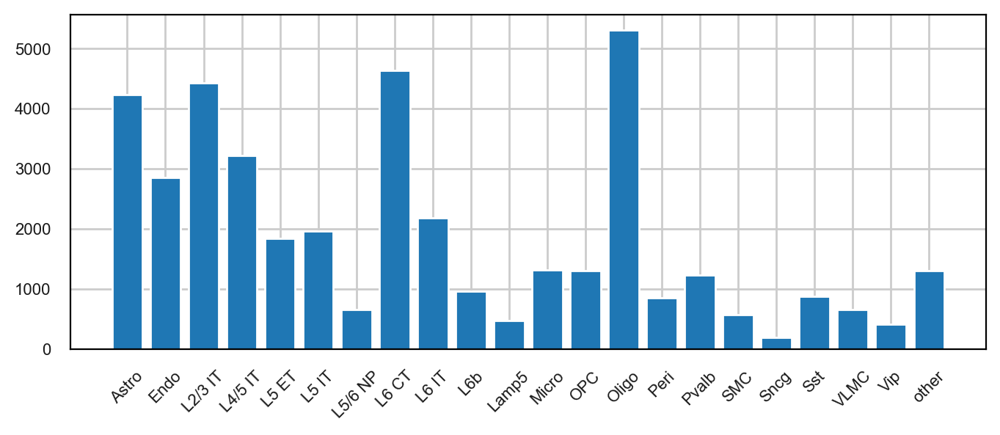

In [106]:
# print class number
fig, ax = plt.subplots(figsize=(8,3), dpi=100)
ax.bar(types, counts)
ax.set_xticklabels(types, rotation=45)
fig.show()

# 9. Redo prediction for manual labels

Check consistency between manual labels vs. predict labels

In [112]:
prediction_column = 'subclass_manual_label_predict'

ref_cluster_column = 'subclass'

# determine which class to query
query_cluster_column = 'subclass_manual_label'

print(f'Predict cell types: {query_cluster_column}')
clsf.predict_classes(nnc, merged_adata, prediction_column, genes)
 
    
## Count predictions
prediction_counts = merged_adata.obs[[query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')

Predict cell types: subclass_manual_label


C:\Users\puzheng\AppData\Local\Temp\2/ipykernel_62908/2890568702.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


meta NOT subset; don't know how to subset; dropped


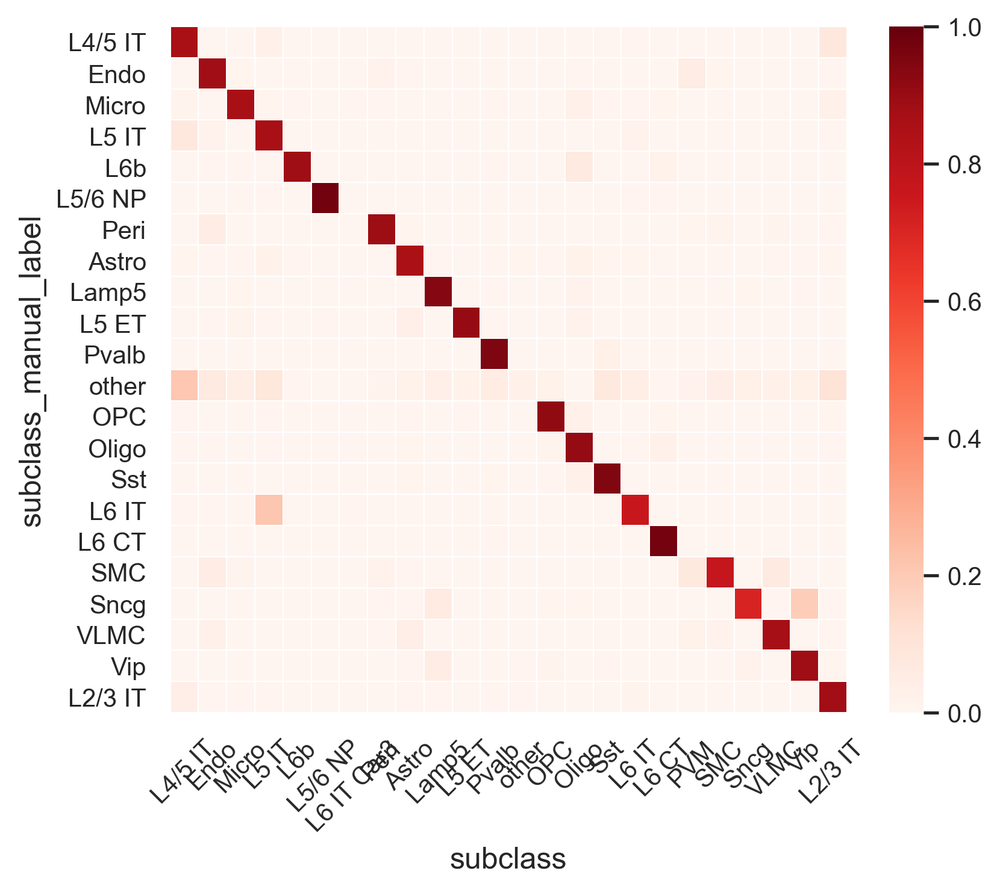

In [122]:
# Plot
fig1=plt.figure(figsize = (6,5))
#sns.set(font_scale=0.2)

ax = sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": 1})
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=10)

plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 45)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column, size=12) 
plt.ylabel(query_cluster_column, size=12)
plt.savefig(os.path.join(figure_folder, 'match_predictClass.pdf'), transparent=True)
plt.show()

20220415


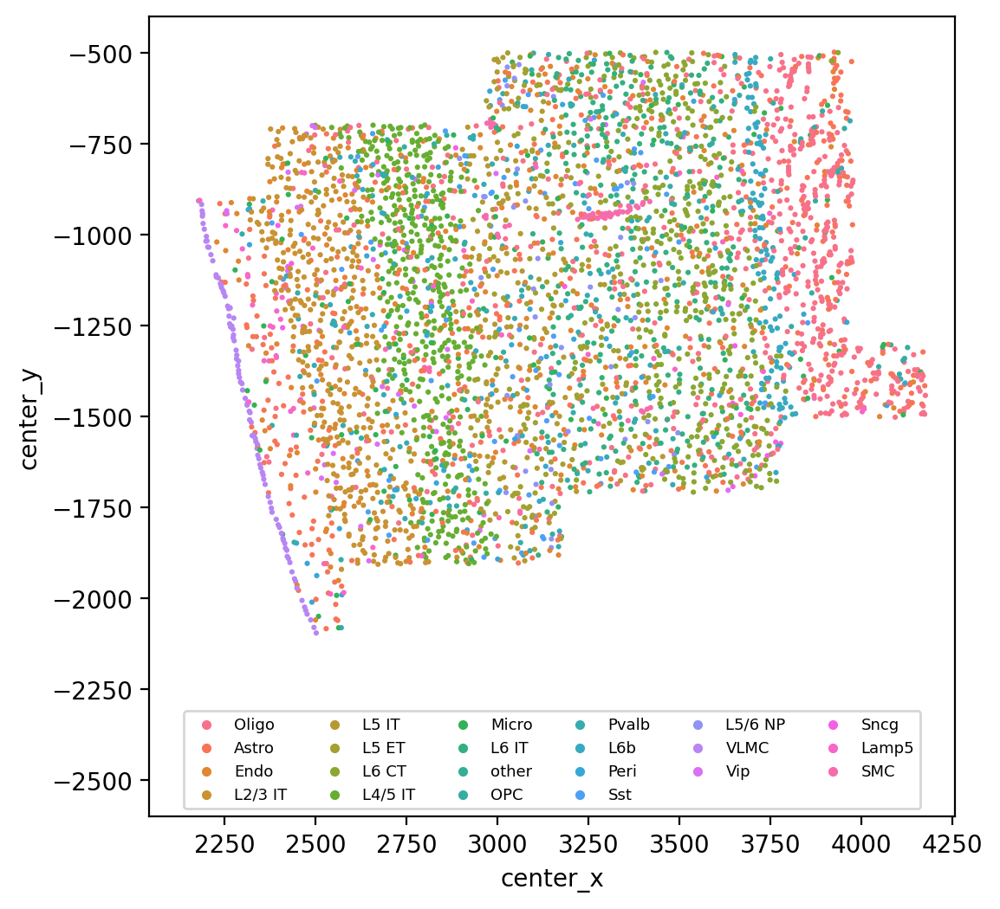

In [194]:
# scatter plot for distributions
plt.style.use('default')

experiments = np.unique(merged_adata.obs['experiment'])
sel_exp_id = 2
print(experiments[sel_exp_id])
sel_obs = merged_adata.obs.loc[merged_adata.obs['experiment']==experiments[sel_exp_id]]

# visualzie the spatial dist for clusters
#plt.style.use('dark_background')
fig, ax = plt.subplots(figsize=(6,6), dpi=100)
ax = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                hue='subclass_manual_label', s=5, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([2050,4250])
plt.ylim([-2600, -400])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8, fontsize=6.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(figure_folder, f'celltype_scatter_all_exp-{experiments[sel_exp_id]}.pdf'), 
            dpi=300, transparent=True)
plt.show()

In [181]:
types

array(['Astro', 'Endo', 'L2/3 IT', 'L4/5 IT', 'L5 ET', 'L5 IT', 'L5/6 NP',
       'L6 CT', 'L6 IT', 'L6b', 'Lamp5', 'Micro', 'OPC', 'Oligo', 'Peri',
       'Pvalb', 'SMC', 'Sncg', 'Sst', 'VLMC', 'Vip', 'other'],
      dtype=object)

meta NOT subset; don't know how to subset; dropped


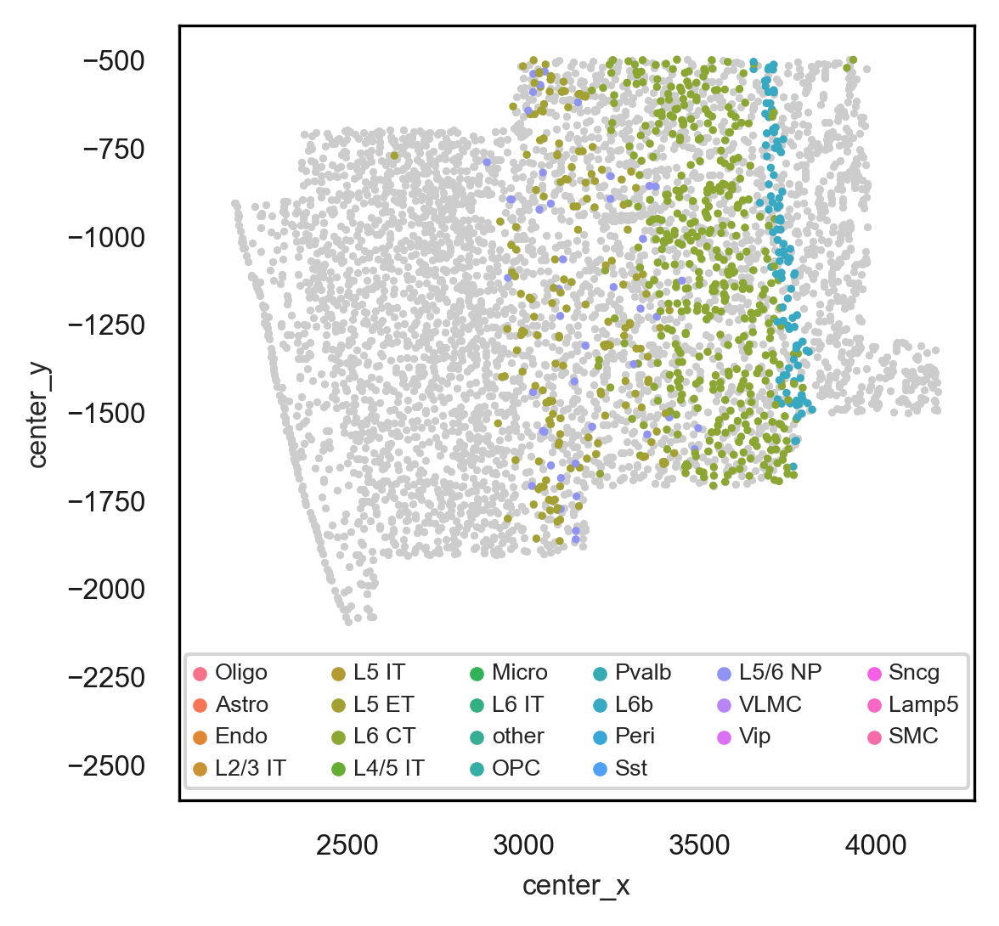

In [183]:
ExciteTypes = ['L5 ET', 'L5/6 NP', 'L6 CT', 'L6b']

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['subclass_manual_label']) if _cls in ExciteTypes]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.8,0.8,0.8], s=5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                hue='subclass_manual_label', s=5, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([2050,4250])
plt.ylim([-2600, -400])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8, fontsize=6.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(figure_folder, f'celltype_scatter_excite_exp-{experiments[sel_exp_id]}.pdf'), transparent=True)
plt.show()

meta NOT subset; don't know how to subset; dropped


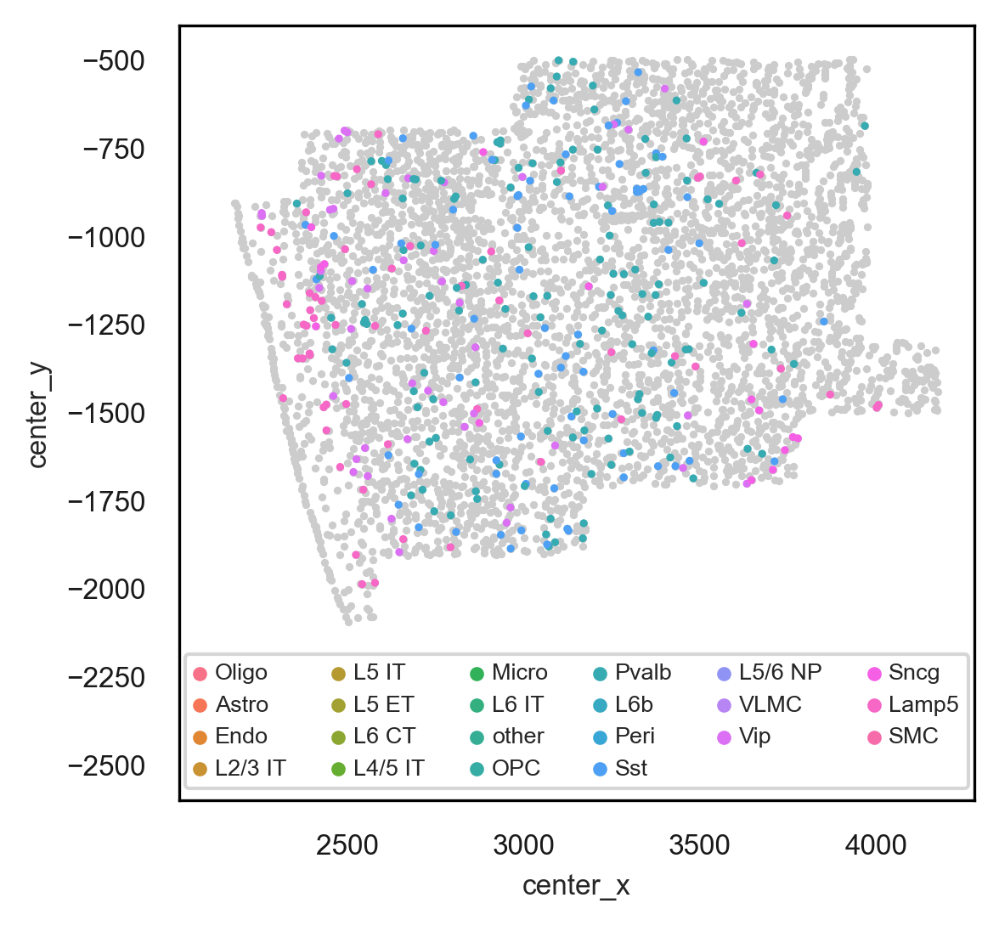

In [180]:
InhbitTypes = ['Lamp5', 'Pvalb', 'Sncg', 'Sst', 'Vip']

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['subclass_manual_label']) if _cls in InhbitTypes]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.8,0.8,0.8], s=5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                hue='subclass_manual_label', s=5, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([2050,4250])
plt.ylim([-2600, -400])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8, fontsize=6.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(figure_folder, f'celltype_scatter_inhibit_exp-{experiments[sel_exp_id]}.pdf'), transparent=True)
plt.show()

meta NOT subset; don't know how to subset; dropped


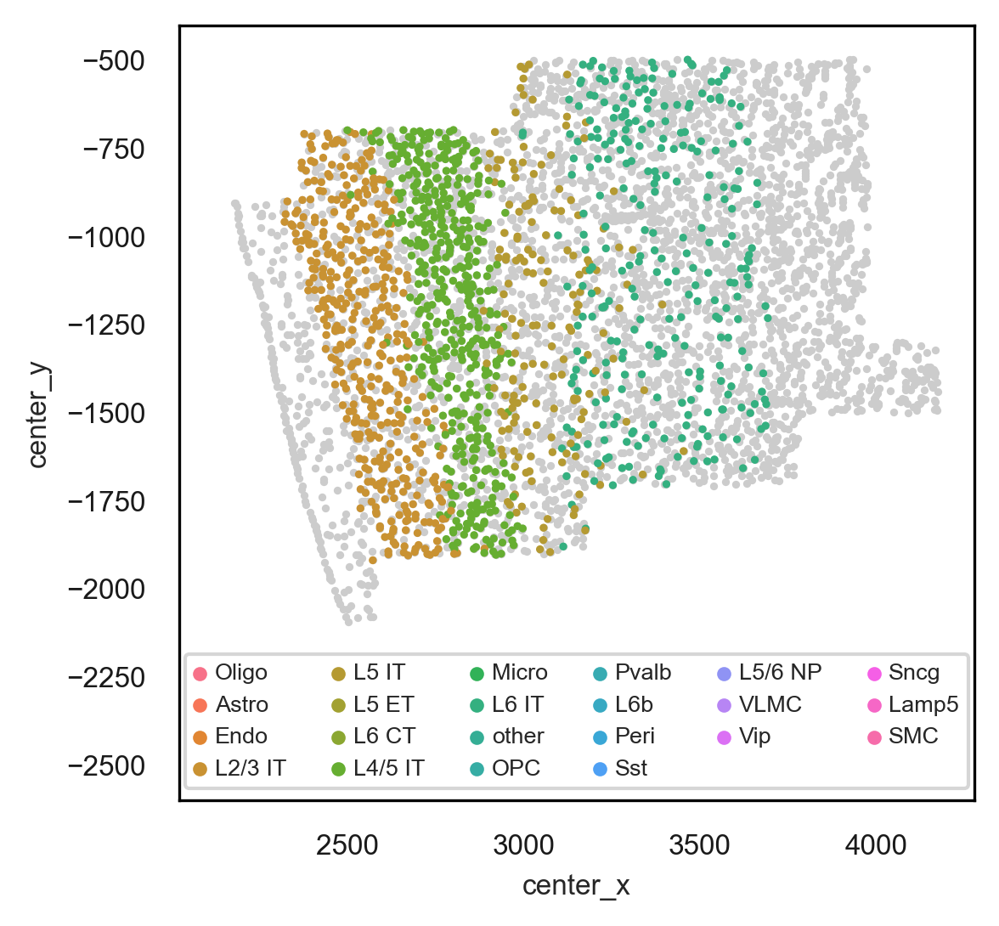

In [182]:
ITTypes = ['L2/3 IT', 'L4/5 IT', 'L5 IT', 'L6 IT']

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['subclass_manual_label']) if _cls in ITTypes]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.8,0.8,0.8], s=5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                hue='subclass_manual_label', s=5, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([2050,4250])
plt.ylim([-2600, -400])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8, fontsize=6.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(figure_folder, f'celltype_scatter_IT_exp-{experiments[sel_exp_id]}.pdf'), transparent=True)
plt.show()

meta NOT subset; don't know how to subset; dropped


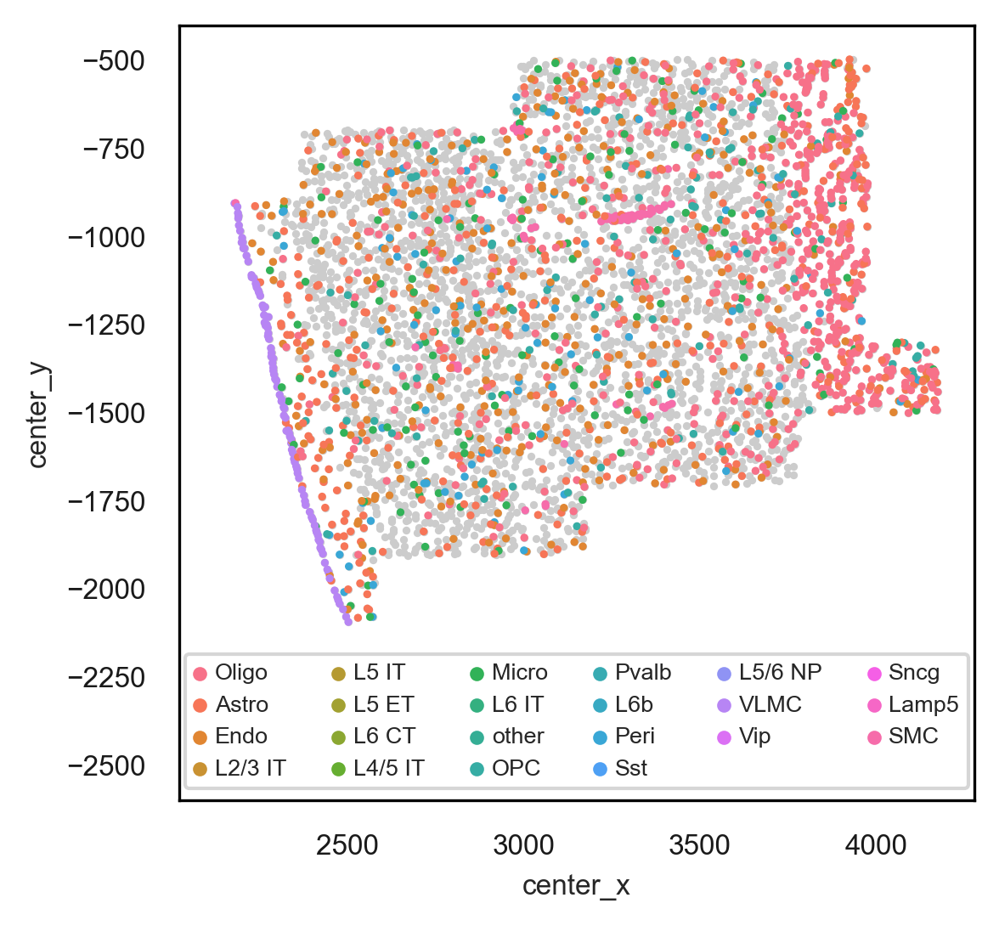

In [177]:
nonNeuTypes = ['Astro', 'Endo', 'Micro', 'OPC', 'Oligo', 'Peri', 'SMC', 'VLMC',]

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['subclass_manual_label']) if _cls in nonNeuTypes]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.8,0.8,0.8], s=5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                hue='subclass_manual_label', s=5, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([2050,4250])
plt.ylim([-2600, -400])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8, fontsize=6.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(figure_folder, f'celltype_scatter_nonNeu_exp-{experiments[sel_exp_id]}.pdf'), transparent=True)
plt.show()

# 10. Save manually labeled data

In [108]:
save_filename = os.path.join(os.path.join(save_folder, 'manual_labeled_data.h5ad'))

overwrite = True

if not os.path.exists(save_filename) or overwrite:
    print(f"save merged_adata into file: {save_filename}")
    merged_adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")

save merged_adata into file: I:\MERFISH_Analysis\Merged_MOP\manual_labeled_data.h5ad


# dark mode

In [185]:
dark_figure_folder = os.path.join(figure_folder, 'dark')
print(dark_figure_folder)
if not os.path.exists(dark_figure_folder):
    os.makedirs(dark_figure_folder)

I:\MERFISH_Analysis\Merged_MOP\Figures_0626\dark


In [200]:
plt.style.use('dark_background')


20220415


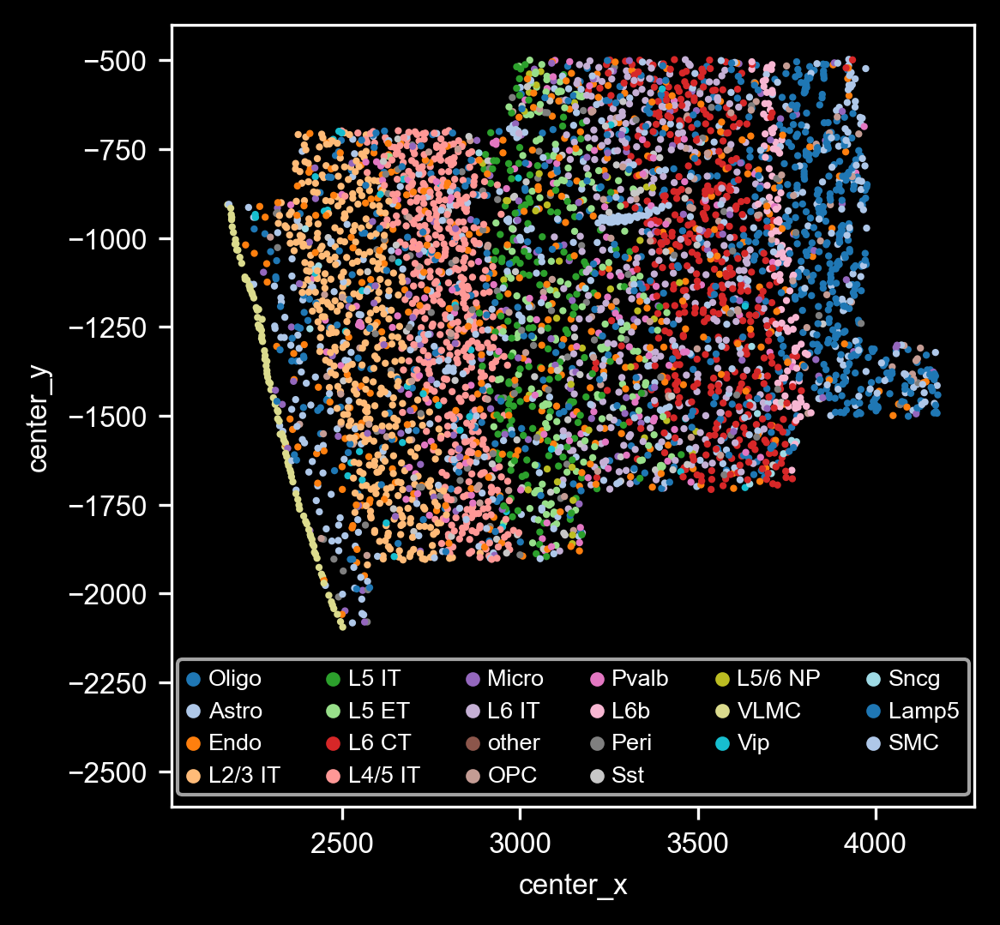

In [260]:
# scatter plot for distributions
experiments = np.unique(merged_adata.obs['experiment'])
sel_exp_id = 2
print(experiments[sel_exp_id])
sel_obs = merged_adata.obs.loc[merged_adata.obs['experiment']==experiments[sel_exp_id]]

# visualzie the spatial dist for clusters
#plt.style.use('dark_background')
ax = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                     palette='tab20',
                     hue='subclass_manual_label', s=4, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([2050,4250])
plt.ylim([-2600, -400])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8, fontsize=6.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(dark_figure_folder, f'celltype_scatter_all_exp-{experiments[sel_exp_id]}.png'), transparent=True)
plt.show()

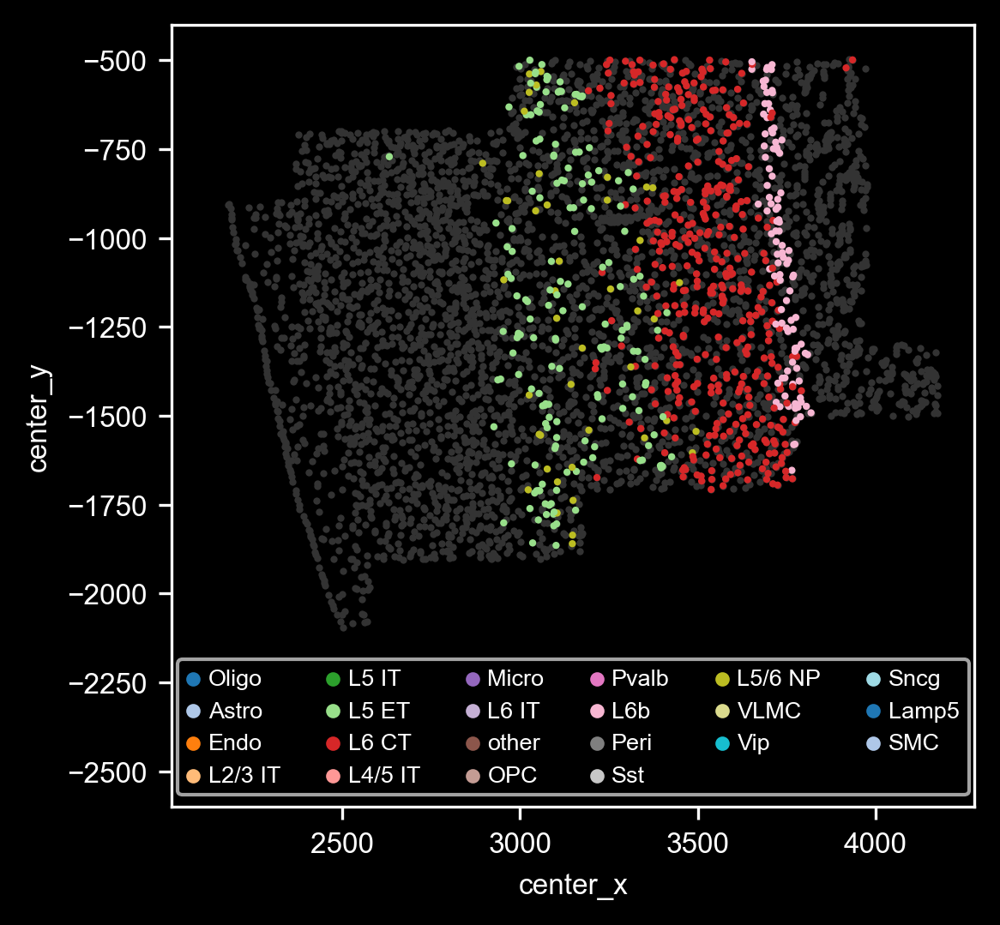

In [261]:
ExciteTypes = ['L5 ET', 'L5/6 NP', 'L6 CT', 'L6b']

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['subclass_manual_label']) if _cls in ExciteTypes]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.2,0.2,0.2], s=4, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                hue='subclass_manual_label', s=4, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([2050,4250])
plt.ylim([-2600, -400])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8, fontsize=6.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(dark_figure_folder, f'celltype_scatter_excite_exp-{experiments[sel_exp_id]}.png'), transparent=True)
plt.show()

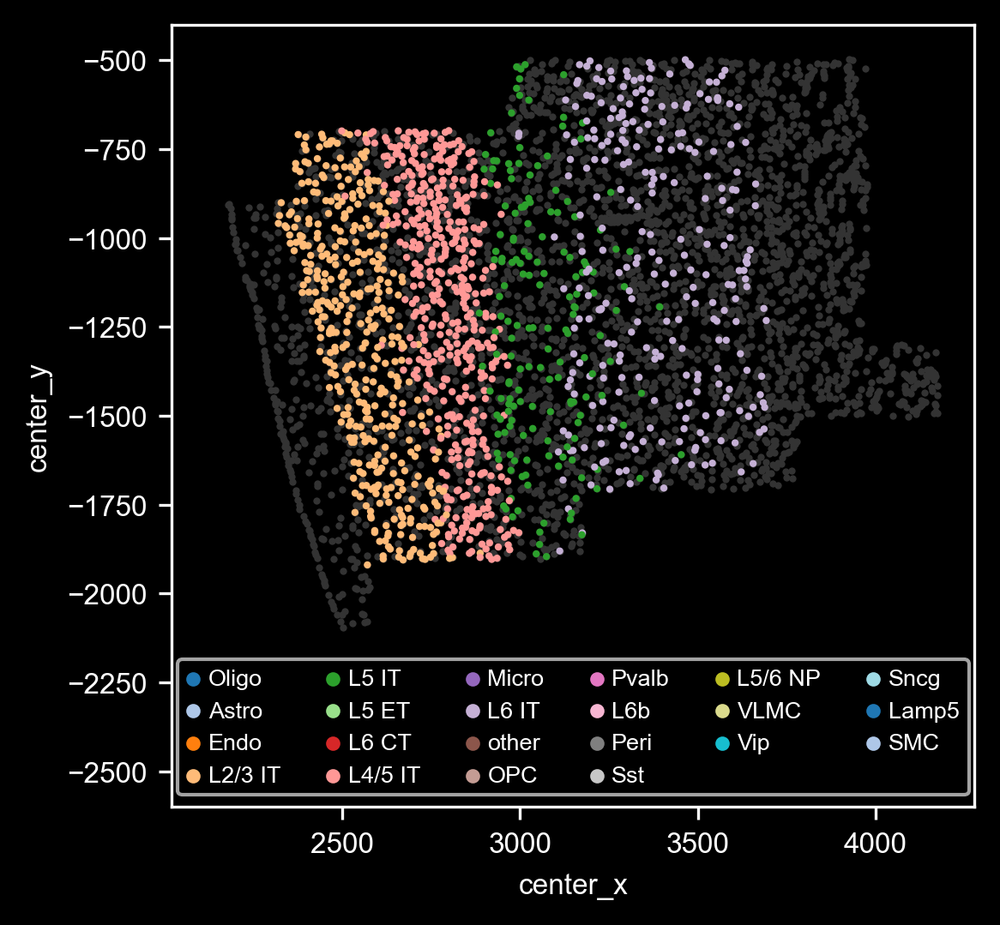

In [262]:
ITTypes = ['L2/3 IT', 'L4/5 IT', 'L5 IT', 'L6 IT']

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['subclass_manual_label']) if _cls in ITTypes]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.2,0.2,0.2], s=4, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                hue='subclass_manual_label', s=4, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([2050,4250])
plt.ylim([-2600, -400])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8, fontsize=6.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(dark_figure_folder, f'celltype_scatter_IT_exp-{experiments[sel_exp_id]}.png'), transparent=True)
plt.show()

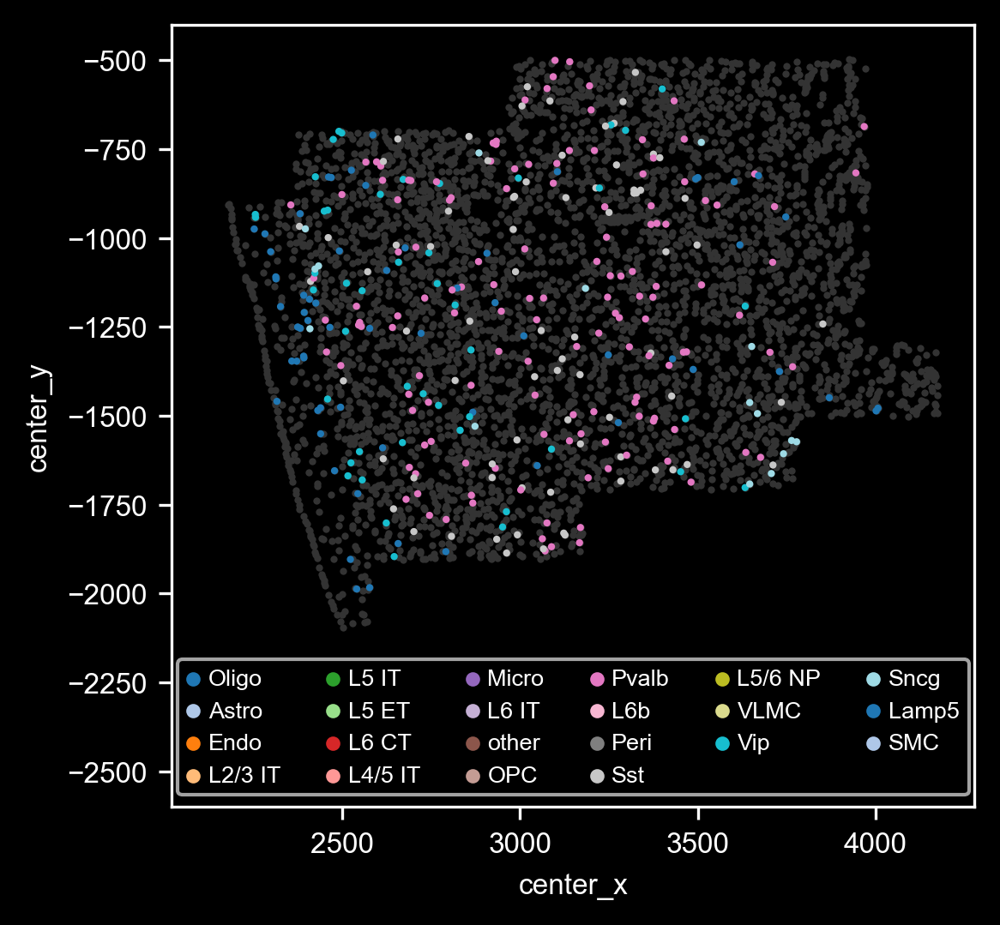

In [263]:
InhbitTypes = ['Lamp5', 'Pvalb', 'Sncg', 'Sst', 'Vip']

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['subclass_manual_label']) if _cls in InhbitTypes]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.2,0.2,0.2], s=4, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                hue='subclass_manual_label', s=4, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([2050,4250])
plt.ylim([-2600, -400])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8, fontsize=6.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(dark_figure_folder, f'celltype_scatter_inhibit_exp-{experiments[sel_exp_id]}.png'), transparent=True)
plt.show()

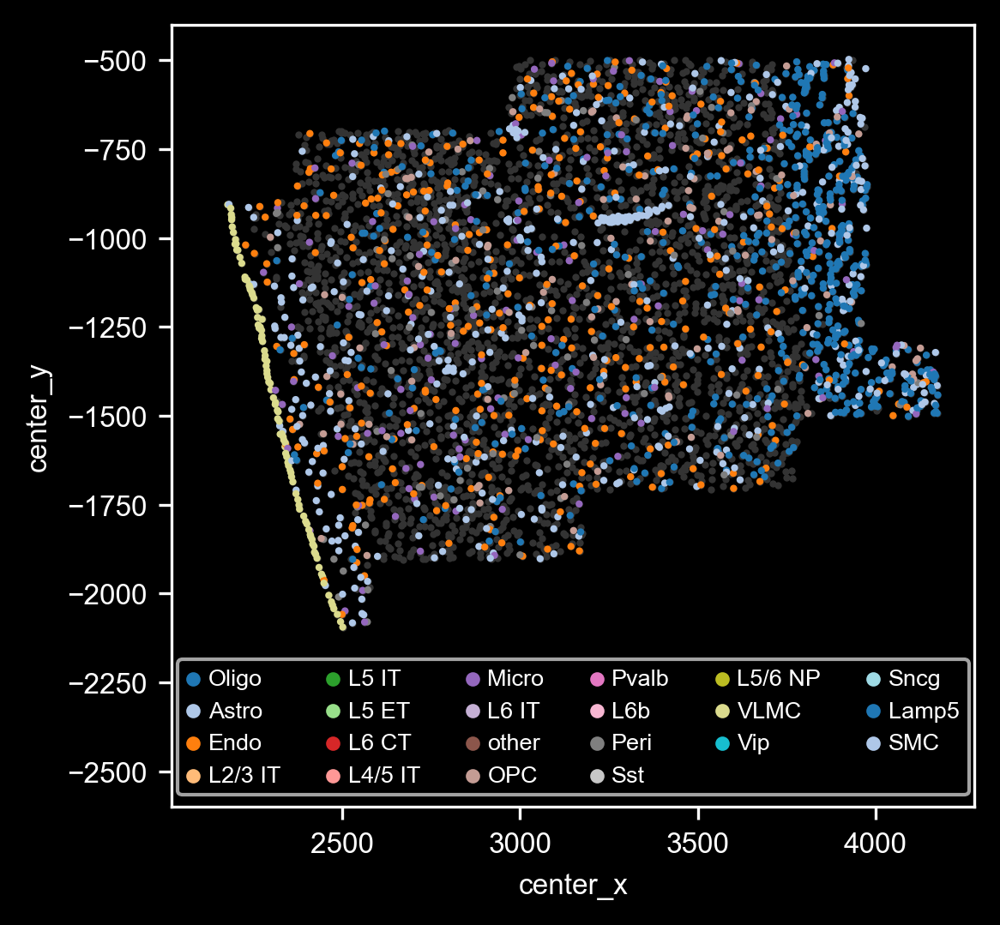

In [264]:
nonNeuTypes = ['Astro', 'Endo', 'Micro', 'OPC', 'Oligo', 'Peri', 'SMC', 'VLMC',]

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['subclass_manual_label']) if _cls in nonNeuTypes]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.2,0.2,0.2], s=4, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                hue='subclass_manual_label', s=4, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
plt.xlim([2050,4250])
plt.ylim([-2600, -400])

hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8, fontsize=6.5, markerscale=0.5, scatterpoints=1)
plt.savefig(os.path.join(dark_figure_folder, f'celltype_scatter_nonNeu_exp-{experiments[sel_exp_id]}.png'), transparent=True)
plt.show()

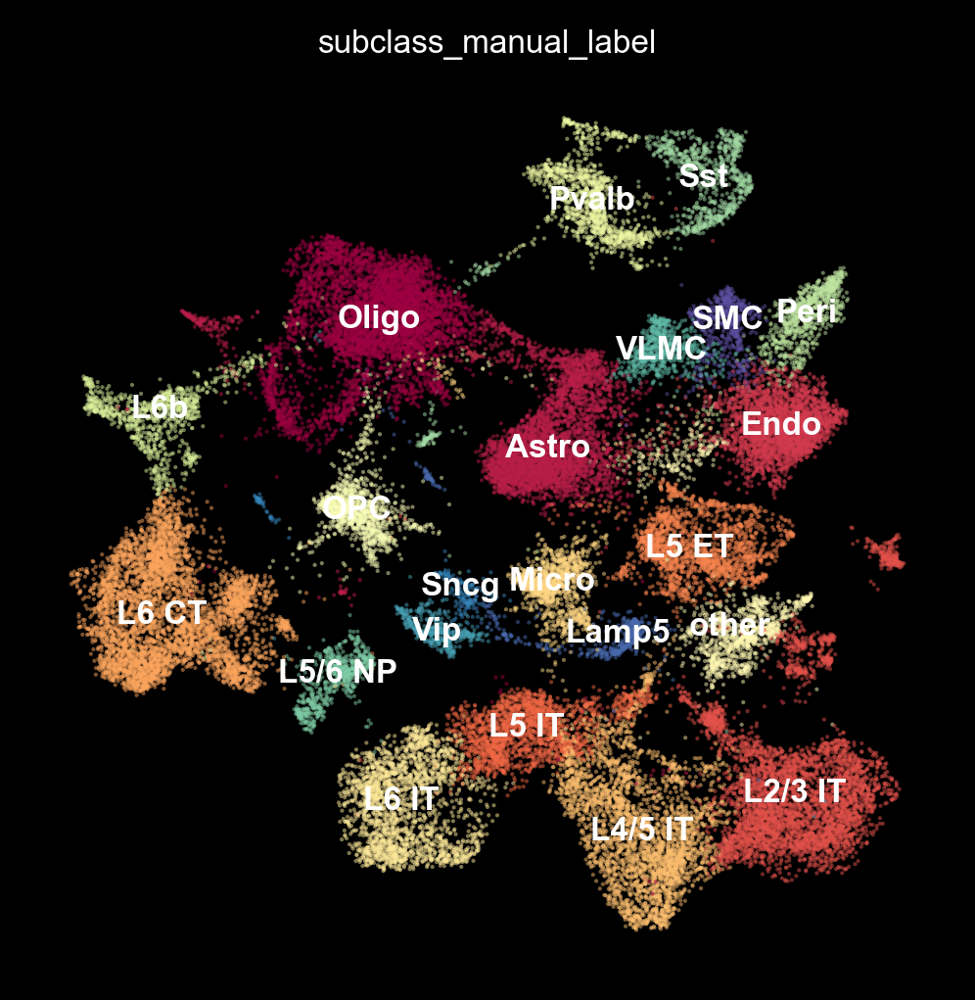

In [301]:
ax = sc.pl.umap(merged_adata, color='subclass_manual_label', 
           legend_loc='on data', legend_fontsize=8,
           size=4, alpha=0.5,
           palette='Spectral', add_outline=False, outline_color=('black','black'), outline_width=(1,0.5),
                save='_dark.png', 
           )
